# Crimes in Boston Analysis

## Latar Belakang

Menurut Cornell Law School, *Crime is behavior, either by act or omission, defined by statutory or common law as deserving of punishment or penalty* ([par 2](https://www.law.cornell.edu/wex/crime#:~:text=A%20crime%20is%20behavior%20that,common%20law%20still%20carries%20force.)). Ini berarti tindakan apapun, baik yang disengaja maupun tidak, yang didefinisikan oleh undang-undang atau hukum sebagai tindakan yang layak untuk mendapatkan hukuman atau sanksi. Walaupun umumnya tindakan pelanggaran hukum ini memerlukan adanya elemen kesengajaan atau niat dari pelakunya, terdapat pelanggaran hukum ringan yang terjadi tanpa ada niat dari orang yang melakukannya, seperti pelanggaran parkir. Tindakan melanggar hukum dikategorikan menjadi pelanggaran besar dari ketertiban umum (kejahatan/*felony*) atau pelanggaran yang lebih ringan (*misdemeanor*) dan diadili menurut prosedur acara pidana.

Di Amerika, menghubungi 911/*contact center* kepolisian merupakan hal yang sangat umum. Selain menindaklanjuti pengaduan, polisi di Amerika biasanya memiliki jadwal patroli untuk mengantisipasi terjadinya pelanggaran hukum. Umumnya saksi mata akan menghubungi 911. 911 *dispatcher* akan mencatat laporan pada form di komputer saat itu juga ketika pelapor masih terhubung dengannya. Bila dirasa ada *emergency* yang perlu ditangani cepat dan segera (misalnya seperti seseorang akan melakukan tindakan yang membahayakan dirinya dan/atau orang lain disekitarnya, atau laporan mengenai perampokan yang sedang terjadi) biasanya *dispatcher* tersebut akan langsung mengirimkan informasi kepada polisi dan paramedis (bila dibutuhkan) saat itu juga untuk mendatangi tempat kejadian perkara/*crime scene*. Informasi ini biasanya mengenai apa yang terjadi dan di mana lokasi kejadian. Polisi dan paramedis langsung menerima laporan dan menindaklanjuti laporan saat itu juga. Setelah selesai menangani kasus, polisi diwajibkan untuk melaporkan semua hal yang terkait dengan kejadian.

Dengan adanya polisi serta adanya pelaporan dan penindakan cepat seperti yang dijelaskan di atas, bukan berarti tindak pelanggaran hukum di Amerika tidak ada. Seseorang melanggar hukum tidak selalu karena balas dendam atau ada hal yang ingin dipenuhi (desakan ekonomi atau kebutuhan lain), namun bisa juga karena lalai atau iri. Hal ini tergantung dari latar belakang pelaku. Sehingga dapat disimpulkan bahwa pelanggaran hukum tidak dapat dihilangkan, namun bisa dicegah dengan tindakan-tindakan *preventive* dari *law enforcement*.

## Rumusan Masalah

Diambil dari *website* [*City of Boston*](https://www.boston.gov/departments/police), *"The Boston Police Department is dedicated to working in partnership with the community to fight crime. We work to improve the quality of life in our neighborhoods.* Boston PD bekerja sama dengan masyarakat saling membantu untuk menciptakan kualitas hidup yang lebih baik. **Kepolisian Boston berkomitmen untuk menekan tingkat kejahatan** di wilayahnya.

*The executive head of the department* of Boston PD, dalam hal ini komisaris kepolisian, bersama-sama dengan pejabat tinggi Boston PD ingin mengevaluasi kejadian pelanggaran hukum berat maupun ringan yang terjadi di wilayah Boston, Massachusetts, USA, dari Juni 2015 hingga September 2018 untuk mendapatkan *insight*, sehingga pelayanan yang diberikan untuk masyarakat Boston dapat ditingkatkan dan komitmen untuk menciptakan kualitas hidup yang lebih baik di Boston dapat terlaksana. Sebagai seorang *criminology consultant*, saya akan menjawab pertanyaan "apakah tindak pelanggaran hukum di Boston sudah berhasil ditekan" dengan rumusan masalah sebagai berikut.

**Bagaimana trend pelanggaran hukum di Boston?**

Nanti akan dibahas jenis pelanggaran hukum yang paling banyak terjadi, waktu-waktu umumnya pelanggaran hukum terjadi, dan lokasi dengan tingkat pelanggaran tertinggi. Apakah keberadaan Boston PD sudah membantu mengurangi tindak pelanggaran hukum? Apa rekomendasi yang dapat diberikan agar Boston PD dapat memberikan rasa aman yang lebih kepada masyarakat Boston?

## Data

### Data Preparation

Dataset didapatkan dari Kaggle yang juga dapat diambil langsung dari website *Boston Analyze*. Data disediakan oleh Boston Police Department (BPD). Dataset dapat diakses [di Kaggle](https://www.kaggle.com/datasets/AnalyzeBoston/crimes-in-boston) dan di *website* [Analyze Boston](https://data.boston.gov/dataset/crime-incident-reports-august-2015-to-date-source-new-system). 

In [1]:
import pandas as pd # for data analysis dan manipulation
import numpy as np # for working with numerical data
import geopandas as gpd
import math

import matplotlib as mpl
import matplotlib.pyplot as plt # for creating static, animated, and interactive visualizations
%matplotlib inline

import seaborn as sns # for making statistical graphics

import folium
from folium import Choropleth, Circle, Marker, Map
from folium.plugins import HeatMap, MarkerCluster

import plotly.express as px
import plotly.graph_objects as go

import warnings
warnings.filterwarnings("ignore")

### Data of Crimes in Boston

In [2]:
df_crime = pd.read_csv('crime.csv', encoding="latin1")
df_crime.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,NaN,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,LINCOLN ST,42.357791,-71.139371,"(42.35779134, -71.13937053)"
1,I182070943,1402,Vandalism,VANDALISM,C11,347,NaN,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,HECLA ST,42.306821,-71.060300,"(42.30682138, -71.06030035)"
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,NaN,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,CAZENOVE ST,42.346589,-71.072429,"(42.34658879, -71.07242943)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,NaN,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,NEWCOMB ST,42.334182,-71.078664,"(42.33418175, -71.07866441)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,NaN,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,DELHI ST,42.275365,-71.090361,"(42.27536542, -71.09036101)"


### Offense Codes

In [3]:
df_code = pd.read_csv('offense_codes.csv', encoding="latin1")
df_code

,CODE,NAME
0,612,LARCENY PURSE SNATCH - NO FORCE
1,613,LARCENY SHOPLIFTING
2,615,LARCENY THEFT OF MV PARTS & ACCESSORIES
3,1731,INCEST
4,3111,LICENSE PREMISE VIOLATION
...,...,...
571,1806,DRUGS - CLASS B TRAFFICKING OVER 18 GRAMS
572,1807,DRUGS - CLASS D TRAFFICKING OVER 50 GRAMS
573,1610,HUMAN TRAFFICKING - COMMERCIAL SEX ACTS
574,2010,HOME INVASION


### Copy Data

Kopi data agar data asli tidak terganggu

In [4]:
crime_copy = df_crime.copy()
crime_copy.head()

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_CODE_GROUP,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,UCR_PART,STREET,Lat,Long,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,NaN,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,LINCOLN ST,42.357791,-71.139371,"(42.35779134, -71.13937053)"
1,I182070943,1402,Vandalism,VANDALISM,C11,347,NaN,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,HECLA ST,42.306821,-71.060300,"(42.30682138, -71.06030035)"
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,NaN,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,CAZENOVE ST,42.346589,-71.072429,"(42.34658879, -71.07242943)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,NaN,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,NEWCOMB ST,42.334182,-71.078664,"(42.33418175, -71.07866441)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,NaN,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,DELHI ST,42.275365,-71.090361,"(42.27536542, -71.09036101)"


In [5]:
offense_code_copy = df_code.copy()
offense_code_copy.head()

,CODE,NAME
0,612,LARCENY PURSE SNATCH - NO FORCE
1,613,LARCENY SHOPLIFTING
2,615,LARCENY THEFT OF MV PARTS & ACCESSORIES
3,1731,INCEST
4,3111,LICENSE PREMISE VIOLATION


## Data Understanding and Cleaning

### Data Understanding and Cleaning

Sebelum masuk ke dalam analisis, perlu dilakukan tahapan ***data understanding*** untuk mengetahui anomali-anomali pada dataset yang akan ditangani dalam tahapan ***data cleaning***. Setiap penanganan anomali yang dilakukan disertai dengan justifikasi langkah yang akan diambil, baik secara *domain knowledge* maupun secara statistik.

Pertama, lihat list nama kolom pada data.

In [6]:
# iterating the columns -> list nama kolom
for col in crime_copy.columns:
    print(col)

INCIDENT_NUMBER
OFFENSE_CODE
OFFENSE_CODE_GROUP
OFFENSE_DESCRIPTION
DISTRICT
REPORTING_AREA
SHOOTING
OCCURRED_ON_DATE
YEAR
MONTH
DAY_OF_WEEK
HOUR
UCR_PART
STREET
Lat
Long
Location


Dataset *Crimes in Boston* ini berisi informasi mengenai waktu, lokasi, dan kejahatan/pelanggaran hukum yang terjadi. Pahami dulu isi setiap kolom. Definisi kolom didapat dari [*Analyze Boston*](https://data.boston.gov/dataset/crime-incident-reports-august-2015-to-date-source-new-system/resource/9c30453a-fefa-4fe0-b51a-5fc09b0f4655).

In [7]:
field_explanation = pd.read_excel("rmscrimeincidentfieldexplanation.xlsx")
field_explanation

,"Field Name, Data Type, Required",Description
0,"[incident_num] [varchar](20) NOT NULL,",Internal BPD report number
1,"[offense_code][varchar](25) NULL,",Numerical code of offense description
2,[Offense_Code_Group_Description][varchar](80) ...,Internal categorization of [offense_description]
3,"[Offense_Description][varchar](80) NULL,",Primary descriptor of incident
4,"[district] [varchar](10) NULL,",What district the crime was reported in
5,"[reporting_area] [varchar](10) NULL,",RA number associated with the where the crime ...
6,"[shooting][char] (1) NULL,",Indicated a shooting took place.
7,"[occurred_on] [datetime2](7) NULL,",Earliest date and time the incident could have...
8,"[UCR_Part] [varchar](25) NULL,","Universal Crime Reporting Part number (1,2, 3)"
9,"[street] [varchar](50) NULL,",Street name the incident took place


Pada tabel *data_crime*, terdapat kolom *Year*, Month, *Day*, dan *Hour*, yang merupakan detail waktu kejadian, seperti yang terdapat pada kolom *Occurred_On*. Selain itu jg terdapat kolom *Latitude* dan *Longitude* yang menjadi isi kolom *Location*.

Kemudian seragamkan nama kolom dengan mengganti nama setiap kolom.

In [8]:
# mengganti nama kolom

data_crime = crime_copy.rename(columns= {
                    "INCIDENT_NUMBER": "Incident_ID",
                    "OFFENSE_CODE":"Offense_Code",
                    "OFFENSE_CODE_GROUP":"Offense_Code_Group",
                    "OFFENSE_DESCRIPTION": "Offense_Description",
                    "DISTRICT": "District",
                    "REPORTING_AREA":"Reporting_Area",
                    "SHOOTING":"Shooting",
                    "OCCURRED_ON_DATE":"Occurred_On",
                    "YEAR":"Year",
                    "MONTH":"Month",
                    "DAY_OF_WEEK":"Day",
                    "HOUR":"Hour",
                    "UCR_PART":"UCR",
                    "STREET":"Street",
                    "Lat":"Latitude",
                    "Long":"Longitude"})

In [9]:
offense_code = offense_code_copy.rename(columns= {
                    "CODE": "Offense_Code",
                    "NAME":"Name"})

In [10]:
# tabel data_crime setelah ganti nama kolom

data_crime.head()

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Street,Latitude,Longitude,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,NaN,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,LINCOLN ST,42.357791,-71.139371,"(42.35779134, -71.13937053)"
1,I182070943,1402,Vandalism,VANDALISM,C11,347,NaN,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,HECLA ST,42.306821,-71.060300,"(42.30682138, -71.06030035)"
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,NaN,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,CAZENOVE ST,42.346589,-71.072429,"(42.34658879, -71.07242943)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,NaN,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,NEWCOMB ST,42.334182,-71.078664,"(42.33418175, -71.07866441)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,NaN,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,DELHI ST,42.275365,-71.090361,"(42.27536542, -71.09036101)"


In [11]:
# table offense_code setelah ganti nama kolom

offense_code

,Offense_Code,Name
0,612,LARCENY PURSE SNATCH - NO FORCE
1,613,LARCENY SHOPLIFTING
2,615,LARCENY THEFT OF MV PARTS & ACCESSORIES
3,1731,INCEST
4,3111,LICENSE PREMISE VIOLATION
...,...,...
571,1806,DRUGS - CLASS B TRAFFICKING OVER 18 GRAMS
572,1807,DRUGS - CLASS D TRAFFICKING OVER 50 GRAMS
573,1610,HUMAN TRAFFICKING - COMMERCIAL SEX ACTS
574,2010,HOME INVASION



Sekarang lihat informasi umum dari dataset *crime*.

In [12]:
a,b = data_crime.shape

print(f"Jumlah data di dataset crime adalah {a} baris dan {b} kolom.\n")

data_crime.info()

Jumlah data di dataset crime adalah 319073 baris dan 17 kolom.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319073 entries, 0 to 319072
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   Incident_ID          319073 non-null  object 
 1   Offense_Code         319073 non-null  int64  
 2   Offense_Code_Group   319073 non-null  object 
 3   Offense_Description  319073 non-null  object 
 4   District             317308 non-null  object 
 5   Reporting_Area       319073 non-null  object 
 6   Shooting             1019 non-null    object 
 7   Occurred_On          319073 non-null  object 
 8   Year                 319073 non-null  int64  
 9   Month                319073 non-null  int64  
 10  Day                  319073 non-null  object 
 11  Hour                 319073 non-null  int64  
 12  UCR                  318983 non-null  object 
 13  Street               308202 non-null  object 
 14  Lati

In [13]:
pd.set_option('display.max_colwidth', -1)
# data unique di tiap kolom

listItem = []
for col in data_crime.columns :
    listItem.append( [col, data_crime[col].nunique(), data_crime[col].unique()])

tabel1Desc = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'],
                     data=listItem)
tabel1Desc

,Column Name,Number of Unique,Unique Sample
0,Incident_ID,282517,"[I182070945, I182070943, I182070941, I182070940, I182070938, I182070936, I182070933, I182070932, I182070931, I182070929, I182070928, I182070927, I182070923, I182070922, I182070921, I182070920, I182070919, I182070918, I182070917, I182070915, I182070913, I182070911, I182070910, I182070909, I182070908, I182070906, I182070905, I182070904, I182070903, I182070901, I182070900, I182070898, I182070897, I182070895, I182070893, I182070892, I182070891, I182070890, I182070889, I182070888, I182070887, I182070886, I182070885, I182070882, I182070881, I182070880, I182070879, I182070877, I182070876, I182070875, I182070874, I182070873, I182070872, I182070871, I182070870, I182070868, I182070866, I182070865, I182070863, I182070862, I182070861, I182070860, I182070859, I182070858, I182070857, I182070856, I182070855, I182070854, I182070852, I182070851, I182070850, I182070849, I182070847, I182070846, I182070844, I182070843, I182070842, I182070841, I182070840, I182070839, I182070838, I182070837, I182070836, I182070835, I182070834, I182070833, I182070832, I182070831, I182070830, I182070829, I182070828, I182070827, I182070826, I182070825, I182070824, I182070823, I182070822, I182070820, I182070819, I182070818, ...]"
1,Offense_Code,222,"[619, 1402, 3410, 3114, 3820, 724, 3301, 301, 3108, 2647, 3201, 3006, 3305, 614, 3801, 3803, 522, 3831, 802, 2007, 2900, 2907, 2629, 2662, 3207, 613, 3109, 2612, 1843, 3125, 1841, 3802, 3018, 2405, 617, 3625, 3106, 3501, 3115, 616, 3807, 1102, 1849, 2905, 1810, 1842, 1806, 1848, 1844, 423, 3205, 413, 1501, 3001, 3830, 561, 2914, 2610, 1109, 706, 2403, 3160, 900, 801, 3002, 520, 2648, 670, 615, 3116, 1504, 1830, 361, 2006, 311, 1001, 3810, 2401, 2646, 3821, 3811, 3007, 2660, 1831, 3119, 3170, 1874, 3112, 3502, 735, 612, 560, 381, 3402, 1815, 1107, 2101, 1106, 3202, 1503, ...]"
2,Offense_Code_Group,67,"[Larceny, Vandalism, Towed, Investigate Property, Motor Vehicle Accident Response, Auto Theft, Verbal Disputes, Robbery, Fire Related Reports, Other, Property Lost, Medical Assistance, Assembly or Gathering Violations, Larceny From Motor Vehicle, Residential Burglary, Simple Assault, Restraining Order Violations, Violations, Harassment, Ballistics, Property Found, Police Service Incidents, Drug Violation, Warrant Arrests, Disorderly Conduct, Property Related Damage, Missing Person Reported, Investigate Person, Fraud, Aggravated Assault, License Plate Related Incidents, Firearm Violations, Other Burglary, Arson, Bomb Hoax, Harbor Related Incidents, Counterfeiting, Liquor Violation, Firearm Discovery, Landlord/Tenant Disputes, Missing Person Located, Auto Theft Recovery, Service, Operating Under the Influence, Confidence Games, Search Warrants, License Violation, Commercial Burglary, HOME INVASION, Recovered Stolen Property, Offenses Against Child / Family, Prostitution, Evading Fare, Prisoner Related Incidents, Homicide, Embezzlement, Explosives, Criminal Harassment, Phone Call Complaints, Aircraft, Biological Threat, Manslaughter, Gambling, INVESTIGATE PERSON, HUMAN TRAFFICKING, HUMAN TRAFFICKING - INVOLUNTARY SERVITUDE, Burglary - No Property Taken]"
3,Offense_Description,244,"[LARCENY ALL OTHERS, VANDALISM, TOWED MOTOR VEHICLE, INVESTIGATE PROPERTY, M/V ACCIDENT INVOLVING PEDESTRIAN - INJURY, AUTO THEFT, VERBAL DISPUTE, ROBBERY - STREET, FIRE REPORT - HOUSE, BUILDING, ETC., THREATS TO DO BODILY HARM, PROPERTY - LOST, SICK/INJURED/MEDICAL - PERSON, DEMONSTRATIONS/RIOT, LARCENY THEFT FROM MV - NON-ACCESSORY, M/V ACCIDENT - OTHER, M/V ACCIDENT - PERSONAL INJURY, BURGLARY - RESIDENTIAL - NO FORCE, M/V - LEAVING SCENE - PROPERTY DAMAGE, ASSAULT SIMPLE - BATTERY, VIOL. OF RESTRAINING ORDER W NO ARREST, VAL - VIOLATION OF AUTO LAW - OTHER, VAL - OPERATING AFTER REV/SUSP., HARASSMENT, BALLISTICS EVIDENCE/FOUND, PROPERTY - FOUND, LARCENY SHOPLIFTING, SERVICE TO OTHER PD INSIDE OF MA., FIRE REPORT/ALARM - FALSE, DRUGS - POSS CLASS B - INTENT TO MFR DIST DISP, WARRANT ARR

Secara umum dapat disimpulkan bahwa:
1. Dataset Crimes in Boston memiliki 319073 baris dan 17 kolom.
2. Kolom *Offense_Code*, *Year*, *Month*, *Hour*, *Latitude*, dan *Longitude* tidak ada format yang salah dan data sudah benar, dilihat dari *number of unique* dan data *unique*-nya.
3. Tabel berisi informasi mengenai tindak pelanggaran hukum, waktu terjadi, dan tempat kejadian.

Selengkapnya akan dijelaskan di setiap langkah.

Cek sebaran *missing data*

In [14]:
# Total missing values per kolom
data_crime.isna().sum()

Incident_ID            0     
Offense_Code           0     
Offense_Code_Group     0     
Offense_Description    0     
District               1765  
Reporting_Area         0     
Shooting               318054
Occurred_On            0     
Year                   0     
Month                  0     
Day                    0     
Hour                   0     
UCR                    90    
Street                 10871 
Latitude               19999 
Longitude              19999 
Location               0     
dtype: int64

Dari sebaran *missing values*, di dapat nilai kosong pada beberapa 6 kolom, yaitu kolom *District*, *Shooting*, *UCR*, *Street*, *Latitude*, dan *Longitude*.

<AxesSubplot:>

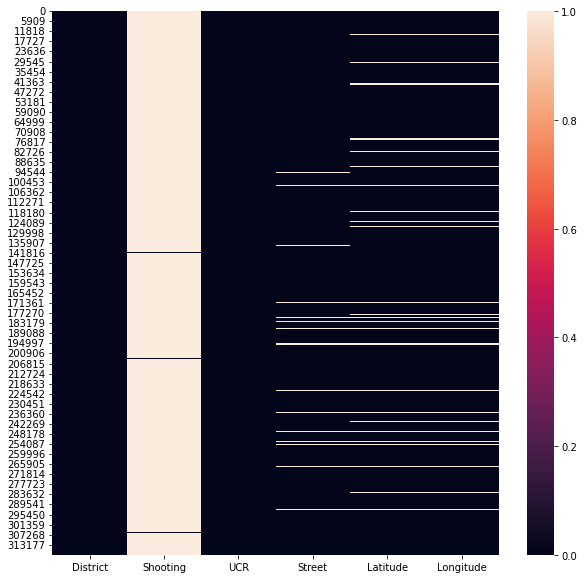

In [15]:
plt.figure(figsize=(10,10))
sns.heatmap(data_crime[["District", "Shooting", "UCR", "Street", "Latitude", "Longitude"]].isna())

Dari cek missing value didapat:
1. Hampir tidak ada data di kolom shooting. Hanya 1019 kasus dari 319,073 kasus (0.3194%) pelanggaran hukum yang terdapat penembakan.
2. Seperti yang dijelaskan di nomor 1, 318,054 kasus pelanggaran hukum yang terjadi tidak melibatkan senjata api. Hal ini akan dibahas lebih lanjut di bawah.
3. District dan UCR memiliki sedikit data kosong.
4. Kolom street memiliki 10,871 (3.4070%) data kosong. Kolom *street* tidak terlalu *relate* karena dapat digantikan dengan *latitude* dan *longitude*. Hal ini akan dijelaskan lebih lanjut di bawah.
5. Latitude dan Longitude memiliki data kosong yang sama. Keduanya mungkin kosong di baris yang sama. Perlu diselidiki lebih jauh.

Sebelum menangani *missing value*, cek bila ada duplikasi data.

In [16]:
# Cek jumlah duplicate

print(data_crime.duplicated().sum())

23


Dari keseluruhan data terdapat 23 baris yang terduplikasi. Perlu dilihat seluruh data yang memiliki duplikasi.

In [17]:
# melihat data yang memiliki duplikat dan mengurutkan values pada kolom Incident_ID -> mengecek list Incident_ID

duplicated = data_crime[data_crime.duplicated()].sort_values("Incident_ID", ascending=True)
duplicated

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Street,Latitude,Longitude,Location
319060,I090321958-00,3125,Warrant Arrests,WARRANT ARREST,C11,355,NaN,2016-02-01 01:43:00,2016,2,Monday,1,Part Three,GENEVA AVE,NaN,NaN,"(0.00000000, 0.00000000)"
319051,I110177502-00,3125,Warrant Arrests,WARRANT ARREST,B2,318,NaN,2015-10-02 21:00:00,2015,10,Friday,21,Part Three,HOMESTEAD ST,42.311277,-71.089093,"(42.31127726, -71.08909334)"
319024,I120470733-00,724,Auto Theft,AUTO THEFT,C6,205,NaN,2016-09-23 19:15:00,2016,9,Friday,19,Part One,A ST,42.346953,-71.051127,"(42.34695268, -71.05112684)"
319009,I130041200-00,3125,Warrant Arrests,WARRANT ARREST,B3,428,NaN,2015-12-07 11:38:00,2015,12,Monday,11,Part Three,DIXWELL ST,42.314334,-71.097914,"(42.31433402, -71.09791405)"
318991,I130202615-00,3125,Warrant Arrests,WARRANT ARREST,B2,587,NaN,2015-08-03 17:23:00,2015,8,Monday,17,Part Three,BURNEY ST,42.331496,-71.099791,"(42.33149596, -71.09979111)"
318978,I130371627-00,3125,Warrant Arrests,WARRANT ARREST,B2,318,NaN,2015-10-02 21:00:00,2015,10,Friday,21,Part Three,HOMESTEAD ST,42.311277,-71.089093,"(42.31127726, -71.08909334)"
318961,I130731947-00,2610,Other,TRESPASSING,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Two,MASSACHUSETTS AVE,42.333391,-71.073120,"(42.33339068, -71.07312006)"
318951,I140036361-00,3125,Warrant Arrests,WARRANT ARREST,E5,680,NaN,2015-07-10 10:15:00,2015,7,Friday,10,Part Three,CORINTH ST,42.286369,-71.130055,"(42.28636893, -71.13005503)"
318946,I140039570-00,3125,Warrant Arrests,WARRANT ARREST,A1,103,NaN,2015-09-28 11:15:00,2015,9,Monday,11,Part Three,WASHINGTON ST,42.356486,-71.059281,"(42.35648631, -71.05928145)"
318940,I140056633-00,3125,Warrant Arrests,WARRANT ARREST,A1,64,NaN,2015-06-16 15:55:00,2015,6,Tuesday,15,Part Three,FRUIT ST,42.362403,-71.069547,"(42.36240281, -71.06954652)"


Pada variabel *duplicated* terdapat 23 value di *Incident_ID* yang memiliki duplikat.

Berikutnya adalah cek baris yang terduplikat (ambil contoh).

In [18]:
# cek baris yang terduplikat (1)

data_crime[data_crime["Incident_ID"] == "I130731947-00"]

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Street,Latitude,Longitude,Location
318959,I130731947-00,2405,Disorderly Conduct,DISORDERLY CONDUCT,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Two,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"
318960,I130731947-00,2610,Other,TRESPASSING,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Two,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"
318961,I130731947-00,2610,Other,TRESPASSING,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Two,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"
318962,I130731947-00,3125,Warrant Arrests,WARRANT ARREST,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Three,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"
318963,I130731947-00,2405,Disorderly Conduct,DISORDERLY PERSON,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Two,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"


In [19]:
# cek baris yang terduplikat (2)

data_crime[data_crime["Incident_ID"] == "I142049917-00"]

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Street,Latitude,Longitude,Location
318824,I142049917-00,1402,Vandalism,VANDALISM,C11,395,NaN,2015-09-03 13:00:00,2015,9,Thursday,13,Part Two,DORCHESTER AVE,42.28526,-71.064441,"(42.28526024, -71.06444063)"
318825,I142049917-00,3125,Warrant Arrests,WARRANT ARREST,C11,395,NaN,2015-09-03 13:00:00,2015,9,Thursday,13,Part Three,DORCHESTER AVE,42.28526,-71.064441,"(42.28526024, -71.06444063)"
318826,I142049917-00,1402,Vandalism,VANDALISM,C11,395,NaN,2015-09-03 13:00:00,2015,9,Thursday,13,Part Two,DORCHESTER AVE,42.28526,-71.064441,"(42.28526024, -71.06444063)"


Dari cek baris yang terduplikat di atas, dapat dikonfirmasi bahwa terdapat 2 baris yang memiliki *value* yang sama pada setiap kolom; baik disengaja atau tidak, *value* yang sama pada setiap kolom diasumsikan sebagai duplikasi. Hal yang sama berlaku untuk 21 baris lainnya.

Penjelasan dari contoh:<br>
Terdapat 2 baris dengan *Incident_ID* I130731947-00 yang memiliki value yang sama pada kolom *Offense_Code*, *Offense_Code_Group*, *Offense_Description*, dan semua kolom lainnya. Duplikasi ini diduga terjadi karena *human error* atau memang ada dua orang yang melakukan *Trespassing* atau masuk ke dalam suatu wilayah tanpa seizin pemilik. Hal ini tidak dapat dikonfirmasi karena tidak ada informasi mengenai identitas pelaku atau berapa orang yang melakukan pelanggaran ini.

Apabila dilihat dari kelima baris dengan *Incident_ID* yang sama di atas, kemungkinan yang terjadi adalah dalam satu laporan kejadian terdapat 5 pelanggaran hukum. Bila diamati dari jenis pelanggaran pada kolom *Offense_Description*, kemungkinan yang terjadi adalah 2 orang yang melakukan *trespassing* yang salah satu atau keduanya melakukan kesalahan *[Disorderly Conduct](https://apps.leg.wa.gov/rcw/default.aspx?cite=9A.84.030)* dan/atau *[Disorderly Person](https://library.municode.com/mi/bad_axe/codes/code_of_ordinances?nodeId=CO_CH8PORE_ARTIIIDIPE)* dan kemudian berakhir dengan penangkapan oleh polisi (*[warrant arrest](https://www.law.cornell.edu/wex/arrest_warrant)*). Namun,tidak ada data yang dapat memastikan sehingga baris yang memiliki duplikat akan dihapus (duplikasinya saja).

In [20]:
# cek ulang jumlah duplikasi

data_crime[data_crime.duplicated()].shape

(23, 17)

Dari tabel yang berisi data duplikasi di atas, dapat dilihat terdapat 23 baris yang memiliki duplikasi. Hapus 23 baris tersebut.

In [21]:
crime = data_crime.drop_duplicates()
crime

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Street,Latitude,Longitude,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,NaN,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,LINCOLN ST,42.357791,-71.139371,"(42.35779134, -71.13937053)"
1,I182070943,1402,Vandalism,VANDALISM,C11,347,NaN,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,HECLA ST,42.306821,-71.060300,"(42.30682138, -71.06030035)"
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,NaN,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,CAZENOVE ST,42.346589,-71.072429,"(42.34658879, -71.07242943)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,NaN,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,NEWCOMB ST,42.334182,-71.078664,"(42.33418175, -71.07866441)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,NaN,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,DELHI ST,42.275365,-71.090361,"(42.27536542, -71.09036101)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319068,I050310906-00,3125,Warrant Arrests,WARRANT ARREST,D4,285,NaN,2016-06-05 17:25:00,2016,6,Sunday,17,Part Three,COVENTRY ST,42.336951,-71.085748,"(42.33695098, -71.08574813)"
319069,I030217815-08,111,Homicide,"MURDER, NON-NEGLIGIENT MANSLAUGHTER",E18,520,NaN,2015-07-09 13:38:00,2015,7,Thursday,13,Part One,RIVER ST,42.255926,-71.123172,"(42.25592648, -71.12317207)"
319070,I030217815-08,3125,Warrant Arrests,WARRANT ARREST,E18,520,NaN,2015-07-09 13:38:00,2015,7,Thursday,13,Part Three,RIVER ST,42.255926,-71.123172,"(42.25592648, -71.12317207)"
319071,I010370257-00,3125,Warrant Arrests,WARRANT ARREST,E13,569,NaN,2016-05-31 19:35:00,2016,5,Tuesday,19,Part Three,NEW WASHINGTON ST,42.302333,-71.111565,"(42.30233307, -71.11156487)"


Dari tabel di atas dapat dilihat jumlah data sekarang adalah 319,050 baris (setelah dikurangi 23 baris) dari semula 319,073 baris.

Dapat dilihat pada tabel di bawah, *Incident_ID* I130731947-00 sekarang hanya memiliki satu pelanggaran dari sebelumnya memiliki dua pelanggaran *trespassing*.

In [22]:
crime[crime["Incident_ID"] == "I130731947-00"]

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Street,Latitude,Longitude,Location
318959,I130731947-00,2405,Disorderly Conduct,DISORDERLY CONDUCT,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Two,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"
318960,I130731947-00,2610,Other,TRESPASSING,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Two,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"
318962,I130731947-00,3125,Warrant Arrests,WARRANT ARREST,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Three,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"
318963,I130731947-00,2405,Disorderly Conduct,DISORDERLY PERSON,D4,172,NaN,2015-07-22 22:00:00,2015,7,Wednesday,22,Part Two,MASSACHUSETTS AVE,42.333391,-71.07312,"(42.33339068, -71.07312006)"


Berikutnya kolom *Street* akan dihilangkan/*drop* karena kolom *location* yang akan digunakan untuk menandakan tempat kejadian pelanggaran. Untuk menunjukkan lokasi, penggunaan koordinat (*latitude* dan *longitude*) akan lebih akurat.

In [23]:
crime.drop(labels="Street", axis=1, inplace=True)

Setelah itu, kolom *latitude* dan *longitude* juga akan dibuang dan diganti dengan kolom *latitude* dan *longitude* yang baru agar tidak ada *missing value* (kolom *location* tidak terdapat *missing value*). Kolom *latitude* dan *longitude* yang baru akan dibuat dengan mengekstrak value dari kolom *location*. Kolom *location* memiliki dua nilai, yaitu *latitude* dan *longitude*, *respectively*.

In [24]:
crime.drop(labels=["Latitude", "Longitude"], axis=1, inplace=True)

Cek lagi *missing value* yang masih ada.

In [25]:
# Total missing values per kolom

crime.isna().sum()

Incident_ID            0     
Offense_Code           0     
Offense_Code_Group     0     
Offense_Description    0     
District               1765  
Reporting_Area         0     
Shooting               318031
Occurred_On            0     
Year                   0     
Month                  0     
Day                    0     
Hour                   0     
UCR                    90    
Location               0     
dtype: int64

Langkah berikutnya adalah menangani *missing value* yang akan dimulai dari kolom dengan *missing value* terbanyak, yaitu *shooting*.

In [26]:
# menghitung jumlah data yang terdapat pada kolom Shooting

crime.value_counts("Shooting")

Shooting
Y    1019
dtype: int64

Dari output di atas, hanya terdapat satu value "Y" sebanyak 1,019 buah pada kolom *Shooting*. Ini berarti hanya 1,019 kejadian yang melibatkan senjata api, sedangkan pada kasus lainnya tidak ada data/NaN (*missing value*). Saya akan mengganti *missing value* menjadi tidak ada senjata api yang terlibat (N). Hal ini dilakukan dengan pertimbangan penembakan dapat berakibat terluka/meninggalnya orang lain, baik secara disengaja (*capital murder and nonnegligent manslaughter*) atau tidak disengaja (*manslaughter by negligence*). Sebagai catatan, kedua hal tersebut di Amerika Serikat merupakan bagian dari UCR Part I atau *serious crimes*. Sehingga kasus apapun yang melibatkan senjata api di Amerika Serikat menjadi salah satu *major crimes* atau kejahatan serius yang "likely to be reported" (source: [FBI](https://ucr.fbi.gov/crime-in-the-u.s/2011/crime-in-the-u.s.-2011/offense-definitions)). Oleh karena itu, bila Boston PD tidak mengisi kolom *Shooting* bisa dikatakan tidak ada senjata api yang terlibat.

In [27]:
crime["Shooting"].fillna(value="N", inplace=True)

In [28]:
crime.value_counts("Shooting")

Shooting
N    318031
Y    1019  
dtype: int64

In [29]:
crime[crime["Shooting"] == "Y"]

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Location
1295,I182069509,413,Aggravated Assault,ASSAULT - AGGRAVATED - BATTERY,E18,540,Y,2018-08-29 23:19:00,2018,8,Wednesday,23,Part One,"(42.25040550, -71.13173740)"
1860,I182068876,413,Aggravated Assault,ASSAULT - AGGRAVATED - BATTERY,B2,183,Y,2018-08-27 22:56:00,2018,8,Monday,22,Part One,"(42.32104169, -71.07215291)"
3259,I182067317,111,Homicide,"MURDER, NON-NEGLIGIENT MANSLAUGHTER",B2,312,Y,2018-08-22 15:00:00,2018,8,Wednesday,15,Part One,"(42.31568920, -71.08951391)"
3260,I182067317,2662,Ballistics,BALLISTICS EVIDENCE/FOUND,B2,312,Y,2018-08-22 15:00:00,2018,8,Wednesday,15,Part Two,"(42.31568920, -71.08951391)"
4107,I182066420,413,Aggravated Assault,ASSAULT - AGGRAVATED - BATTERY,A15,900,Y,2018-08-19 22:46:00,2018,8,Sunday,22,Part One,"(42.37808452, -71.05784115)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317369,I152051161,413,Aggravated Assault,ASSAULT - AGGRAVATED - BATTERY,B2,238,Y,2015-06-20 00:00:00,2015,6,Saturday,0,Part One,"(42.31780762, -71.06684990)"
317370,I152051161,1503,Firearm Violations,"WEAPON - OTHER - CARRYING / POSSESSING, ETC",B2,238,Y,2015-06-20 00:00:00,2015,6,Saturday,0,Part Two,"(42.31780762, -71.06684990)"
317371,I152051161,3125,Warrant Arrests,WARRANT ARREST,B2,238,Y,2015-06-20 00:00:00,2015,6,Saturday,0,Part Three,"(42.31780762, -71.06684990)"
317567,I152050961,413,Aggravated Assault,ASSAULT - AGGRAVATED - BATTERY,B2,286,Y,2015-06-19 21:20:00,2015,6,Friday,21,Part One,"(42.33358389, -71.08554259)"


In [30]:
crime[crime["Shooting"] == "N"]

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Location
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,N,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,"(42.35779134, -71.13937053)"
1,I182070943,1402,Vandalism,VANDALISM,C11,347,N,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,"(42.30682138, -71.06030035)"
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,N,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,"(42.34658879, -71.07242943)"
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,N,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,"(42.33418175, -71.07866441)"
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,N,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,"(42.27536542, -71.09036101)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319068,I050310906-00,3125,Warrant Arrests,WARRANT ARREST,D4,285,N,2016-06-05 17:25:00,2016,6,Sunday,17,Part Three,"(42.33695098, -71.08574813)"
319069,I030217815-08,111,Homicide,"MURDER, NON-NEGLIGIENT MANSLAUGHTER",E18,520,N,2015-07-09 13:38:00,2015,7,Thursday,13,Part One,"(42.25592648, -71.12317207)"
319070,I030217815-08,3125,Warrant Arrests,WARRANT ARREST,E18,520,N,2015-07-09 13:38:00,2015,7,Thursday,13,Part Three,"(42.25592648, -71.12317207)"
319071,I010370257-00,3125,Warrant Arrests,WARRANT ARREST,E13,569,N,2016-05-31 19:35:00,2016,5,Tuesday,19,Part Three,"(42.30233307, -71.11156487)"


In [31]:
# cek lagi total missing values

crime.isna().sum()

Incident_ID            0   
Offense_Code           0   
Offense_Code_Group     0   
Offense_Description    0   
District               1765
Reporting_Area         0   
Shooting               0   
Occurred_On            0   
Year                   0   
Month                  0   
Day                    0   
Hour                   0   
UCR                    90  
Location               0   
dtype: int64

Hal berikutnya yang akan dilakukan adalah menganalisis kolom UCR. Dilansir dari [Uniform Crime Reporting Handbook](https://ucr.fbi.gov/additional-ucr-publications/ucr_handbook.pdf) yang dibuat oleh U.S. Dept. of Justice, Federal Bureau of Investigation (hlm 8), UCR dibagi menjadi dua kategori, yaitu UCR Part I dan UCR Part II. UCR Part I terdiri dari 8 kasifikasi tindak pelanggaran hukum berat/serius berikut.
1. *Criminal Homicide*
2. *Forcible Rape*
3. *Robbery*
4. *Aggravated Assault*
5. *Burglary*
6. *Larceny-theft (except motor vehicle theft)*
7. *Motor Vehicle Theft*
8. *Arson*

UCR Part II mencakup semua klasifikasi lain yang dapat dilaporkan di luar yang didefinisikan sebagai UCR Part I, diantaranya *Other Assaults*, *Forgery and Counterfeiting*, *Fraud*, *Embezzlement*, *Stolen Property: Buying, Receiving, Possessing*, dan *Vandalism*.

Sekarang lihat isi dari kolom UCR.

In [32]:
crime.value_counts("UCR")

UCR
Part Three    158537
Part Two      97563 
Part One      61628 
Other         1232  
dtype: int64

Ternyata Boston PD membagi UCR menjadi 4 kategori, yaitu *Part One*, *Part Two*, *Part Three*, dan *Other*. Tidak ditemukan keterangan lain dari *reliable sources* yang dapat menjelaskan tentang keempat kategori ini, sehingga perlu diteliti lebih jauh.

In [33]:
# melihat isi kolom Offense_Code_Group yang memiliki UCR Part One

crime[crime["UCR"] == "Part One"].value_counts("Offense_Code_Group")

Offense_Code_Group
Larceny                       25935
Larceny From Motor Vehicle    10847
Aggravated Assault            7807 
Residential Burglary          5606 
Auto Theft                    4850 
Robbery                       4624 
Commercial Burglary           1337 
Other Burglary                461  
Homicide                      161  
dtype: int64

In [34]:
# melihat isi kolom Offense_Code_Group yang memiliki UCR Part Two

crime[crime["UCR"] == "Part Two"].value_counts("Offense_Code_Group")

Offense_Code_Group
Other                              17087
Drug Violation                     16545
Simple Assault                     15826
Vandalism                          15414
Violations                         6095 
Fraud                              5829 
Harassment                         4007 
Confidence Games                   3147 
Disorderly Conduct                 2611 
Firearm Violations                 1777 
Restraining Order Violations       1607 
Recovered Stolen Property          1455 
Counterfeiting                     1454 
Liquor Violation                   1052 
Ballistics                         981  
Operating Under the Influence      574  
Offenses Against Child / Family    545  
Evading Fare                       407  
Embezzlement                       296  
Prisoner Related Incidents         230  
Prostitution                       207  
Criminal Harassment                131  
Fire Related Reports               126  
Bomb Hoax                          75 

Dapat dilihat dari kedua list di atas (UCR *Part One* dan UCR *Part Two*), tindak pelanggaran hukum yang secara umum sama dengan yang ditentukan oleh FBI, walaupun terdapat definisi/nama yang berbeda dari FBI. Oleh karena itu, diasumsikan *Part One* dan *Part Two* sudah benar. Sekarang lihat isi dari *Part Three* dan *Other*.

In [35]:
crime[crime["UCR"] == "Part Three"].value_counts("Offense_Code_Group")

Offense_Code_Group
Motor Vehicle Accident Response     37132
Medical Assistance                  23540
Investigate Person                  18749
Verbal Disputes                     13099
Towed                               11287
Investigate Property                11124
Property Lost                       9751 
Warrant Arrests                     8392 
Missing Person Located              4958 
Property Found                      3925 
Missing Person Reported             3766 
Police Service Incidents            2781 
Fire Related Reports                1794 
License Violation                   1701 
Other                               976  
Landlord/Tenant Disputes            968  
Search Warrants                     966  
Assembly or Gathering Violations    955  
Property Related Damage             912  
Firearm Discovery                   698  
License Plate Related Incidents     493  
Service                             285  
Harbor Related Incidents            212  
Aircraft       

In [36]:
crime[crime["UCR"] == "Part Three"].value_counts("Offense_Code_Group").count()

26

In [37]:
crime[crime["UCR"] == "Part Three"].value_counts("Offense_Description")

Offense_Description
SICK/INJURED/MEDICAL - PERSON                      18783
INVESTIGATE PERSON                                 18749
M/V - LEAVING SCENE - PROPERTY DAMAGE              16323
VERBAL DISPUTE                                     13099
TOWED MOTOR VEHICLE                                11287
INVESTIGATE PROPERTY                               11124
PROPERTY - LOST                                    8893 
WARRANT ARREST                                     8392 
M/V ACCIDENT - PROPERTY  DAMAGE                    6557 
M/V ACCIDENT - PERSONAL INJURY                     5131 
MISSING PERSON - LOCATED                           4365 
MISSING PERSON                                     3766 
PROPERTY - FOUND                                   3698 
M/V ACCIDENT - OTHER                               2925 
SERVICE TO OTHER PD INSIDE OF MA.                  2559 
LICENSE PREMISE VIOLATION                          1701 
M/V ACCIDENT INVOLVING PEDESTRIAN - INJURY         1656 
SICK/INJURE

In [38]:
crime[crime["UCR"] == "Part Three"].value_counts("Offense_Description").count()

56

*Part Three* memiliki 158,537 kasus yang terdiri dari 26 grup pelanggaran hukum dengan total 56 jenis pelanggaran hukum yang berbeda. Bila dilihat detail dari *Offense_Description*, *Part Three* adalah kasus-kasus lain yang lebih ringan (E.g. *Verbal Dispute*, *Towed Motor Vehicle*, dan *License Premise Violation*) dan kasus-kasus yang lebih terfokus pada membantu sesama (E.g. *Sick/Injured/Medical - Person*, *Death Investigation*, *Missing Person*, dan *Service to Other PD Inside of MA*). Oleh karena itu, *Part Three* akan dibiarkan walaupun tidak ada di dalam kategori UCR menurut FBI.

In [39]:
# Offense_Code_Group pada UCR Other

crime[crime["UCR"] == "Other"]["Offense_Code_Group"].value_counts()

Auto Theft Recovery                1051
Arson                              94  
License Plate Related Incidents    67  
Other                              10  
Manslaughter                       8   
Burglary - No Property Taken       2   
Name: Offense_Code_Group, dtype: int64

Apabila dilihat satu persatu, keenam nilai pada kolom *Offense_Code_Group* menyerupai pelanggaran yang terdapat pada UCR *Part One*, *Part Two*, dan *Part Three*. Tidak ditemukan data/dokumentasi yang menjelaskan UCR *Other* sehingga keenam *value* *Offense_Code_Group* akan dikategorikan ulang.

In [40]:
# Offense_Code pada UCR Other

crime[crime["UCR"] == "Other"].value_counts("Offense_Description")

Offense_Description
RECOVERED - MV RECOVERED IN BOSTON (STOLEN OUTSIDE BOSTON)    1050
ARSON                                                         94  
RECOVERED STOLEN PLATE                                        67  
PROPERTY - CONCEALING LEASED                                  10  
MANSLAUGHTER - VEHICLE - NEGLIGENCE                           5   
MANSLAUGHTER - NON-VEHICLE - NEGLIGENCE                       2   
AUTO THEFT - OUTSIDE - RECOVERED IN BOSTON                    1   
B&E NON-RESIDENCE DAY - NO PROP TAKEN                         1   
B&E RESIDENCE DAY - NO PROP TAKEN                             1   
KILLING OF FELON BY POLICE                                    1   
dtype: int64

*Auto Theft Recovery*

In [41]:
crime[crime["UCR"] == "Other"][crime["Offense_Code_Group"] == "Auto Theft Recovery"].value_counts("Offense_Description")

Offense_Description
RECOVERED - MV RECOVERED IN BOSTON (STOLEN OUTSIDE BOSTON)    1050
AUTO THEFT - OUTSIDE - RECOVERED IN BOSTON                    1   
dtype: int64

*Auto Theft Recovery* adalah kendaraan apapun yang dicuri, namun sudah dikembalikan ([*source*](https://www.lvmpd.com/en-us/Pages/AutoTheftRecovery.aspx)). Oleh karena itu, *Auto Theft Recovery* diasumsikan bagian dari Recovered Stolen Property.

Kategori baru: UCR *Part Two*

In [42]:
crime["UCR_Updated"] = np.where((crime["UCR"] == "Other") & (crime["Offense_Code_Group"] == "Auto Theft Recovery"), "Part Two", crime["UCR"])

In [43]:
# cek

crime[crime["UCR_Updated"] == "Part Two"][crime["Offense_Code_Group"] == "Auto Theft Recovery"].value_counts("Offense_Description")

Offense_Description
RECOVERED - MV RECOVERED IN BOSTON (STOLEN OUTSIDE BOSTON)    1050
AUTO THEFT - OUTSIDE - RECOVERED IN BOSTON                    1   
dtype: int64

*Arson*

In [44]:
crime[crime["UCR"] == "Other"][crime["Offense_Code_Group"] == "Arson"].value_counts("Offense_Description")

Offense_Description
ARSON    94
dtype: int64

Menurut FBI, *Arson* menjadi bagian dari UCR *Part One*.

Kategori baru: UCR *Part One*

In [45]:
crime["UCR_Updated"] = np.where((crime["UCR"] == "Other") & (crime["Offense_Code_Group"] == "Arson"), "Part One", crime["UCR_Updated"])

In [46]:
crime[crime["UCR_Updated"] == "Part One"][crime["Offense_Code_Group"] == "Arson"].value_counts("Offense_Description")

Offense_Description
ARSON    94
dtype: int64

*License Plate Related Incidents*

In [47]:
crime[crime["UCR"] == "Other"][crime["Offense_Code_Group"] == "License Plate Related Incidents"].value_counts("Offense_Description")

Offense_Description
RECOVERED STOLEN PLATE    67
dtype: int64

Sudah terdapat *License Plate Related Incidents* pada UCR *Part Three*.

Kategori baru: UCR *Part Three*

In [48]:
crime["UCR_Updated"] = np.where((crime["UCR"] == "Other") & (crime["Offense_Code_Group"] == "License Plate Related Incidents"), "Part Three", crime["UCR_Updated"])

In [49]:
crime[crime["UCR_Updated"] == "Part Three"][crime["Offense_Code_Group"] == "License Plate Related Incidents"].value_counts("Offense_Description")

Offense_Description
M/V PLATES - LOST         493
RECOVERED STOLEN PLATE    67 
dtype: int64

In [50]:
# UCR = Part Three dan Offense_Description = M/V PLATES - LOST -> sudah ada sebelumnya
crime[crime["UCR_Updated"] == "Part Three"][crime["Offense_Description"] == "M/V PLATES - LOST"]

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,Location,UCR_Updated
116,I182070808,3205,License Plate Related Incidents,M/V PLATES - LOST,B2,297,N,2018-09-03 09:40:00,2018,9,Monday,9,Part Three,"(42.32171349, -71.08260822)",Part Three
1874,I182068858,3205,License Plate Related Incidents,M/V PLATES - LOST,C11,341,N,2018-08-27 21:42:00,2018,8,Monday,21,Part Three,"(42.30460308, -71.06691869)",Part Three
2082,I182068637,3205,License Plate Related Incidents,M/V PLATES - LOST,D14,784,N,2018-08-18 10:00:00,2018,8,Saturday,10,Part Three,"(42.34996240, -71.14762531)",Part Three
3437,I182067128,3205,License Plate Related Incidents,M/V PLATES - LOST,E18,538,N,2018-08-20 22:00:00,2018,8,Monday,22,Part Three,"(42.25681020, -71.12918339)",Part Three
3443,I182067123,3205,License Plate Related Incidents,M/V PLATES - LOST,C11,347,N,2018-08-21 22:00:00,2018,8,Tuesday,22,Part Three,"(42.30638323, -71.06021218)",Part Three
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317384,I152051144,3205,License Plate Related Incidents,M/V PLATES - LOST,A7,7,N,2015-06-19 18:00:00,2015,6,Friday,18,Part Three,"(42.38776411, -71.00343771)",Part Three
317682,I152050820,3205,License Plate Related Incidents,M/V PLATES - LOST,A1,122,N,2015-06-19 14:30:00,2015,6,Friday,14,Part Three,"(42.34942864, -71.06536641)",Part Three
317743,I152050740,3205,License Plate Related Incidents,M/V PLATES - LOST,C6,228,N,2015-06-18 19:30:00,2015,6,Thursday,19,Part Three,"(42.33411937, -71.02501184)",Part Three
318397,I152049920,3205,License Plate Related Incidents,M/V PLATES - LOST,C11,372,N,2015-06-16 15:19:00,2015,6,Tuesday,15,Part Three,"(42.29158018, -71.04009369)",Part Three


*Other*

In [51]:
crime[crime["UCR"] == "Other"][crime["Offense_Code_Group"] == "Other"].value_counts("Offense_Description")

Offense_Description
PROPERTY - CONCEALING LEASED    10
dtype: int64

The General Court of the Commonwealth of Massachusetts ([*source*](https://malegislature.gov/laws/generallaws/partiv/titlei/chapter266/section87)) menyatakan *"Any person leasing or renting personal property who, with the intent to place such property beyond the control of the owner, conceals or aids or abets the concealment of such property or any part thereof, or fails or refuses to return such property to the owner within ten days after expiration of the lease or rental agreement, or sells, conveys or pledges such property or any part thereof without the written consent of the owner, shall be guilty of larceny of leased or rented personal property."* Ini artinya *Concealing Leased* dapat diasumsikan bagian dari *Larceny* yang menjadi bagian dari UCR *Part One*.

Kategori baru: UCR *Part One*

In [52]:
crime["UCR_Updated"] = np.where((crime["UCR"] == "Other") & (crime["Offense_Code_Group"] == "Other"), "Part One", crime["UCR_Updated"])

In [53]:
crime[crime["UCR_Updated"] == "Part One"][crime["Offense_Code_Group"] == "Other"].value_counts("Offense_Description")

Offense_Description
PROPERTY - CONCEALING LEASED    10
dtype: int64

*Manslaughter*

In [54]:
crime[crime["UCR"] == "Other"][crime["Offense_Code_Group"] == "Manslaughter"].value_counts("Offense_Description")

Offense_Description
MANSLAUGHTER - VEHICLE - NEGLIGENCE        5
MANSLAUGHTER - NON-VEHICLE - NEGLIGENCE    2
KILLING OF FELON BY POLICE                 1
dtype: int64

Ketiga *value* di atas dapat dikatakan bagian dari *Manslaughter by negligence* atau pembunuhan yang terjadi karena ketidaksengajaan atau kelalaian, walaupun yang terakhir (*Killing of Felon by Police*) tidak ada data pendukung yang menyatakan apakah pembunuhan disengaja atau tidak. *Manslaughter by negligence* merupakan bagian dari UCR *Part One*.

Kategori baru: UCR *Part One*

In [55]:
crime["UCR_Updated"] = np.where((crime["UCR"] == "Other") & (crime["Offense_Code_Group"] == "Manslaughter"), "Part One", crime["UCR_Updated"])

In [56]:
crime[crime["UCR_Updated"] == "Part One"][crime["Offense_Code_Group"] == "Manslaughter"].value_counts("Offense_Description")

Offense_Description
MANSLAUGHTER - VEHICLE - NEGLIGENCE        5
MANSLAUGHTER - NON-VEHICLE - NEGLIGENCE    2
KILLING OF FELON BY POLICE                 1
dtype: int64

*Burglary - No Property Taken*

In [57]:
crime[crime["UCR"] == "Other"][crime["Offense_Code_Group"] == "Burglary - No Property Taken"].value_counts("Offense_Description")

Offense_Description
B&E NON-RESIDENCE DAY - NO PROP TAKEN    1
B&E RESIDENCE DAY - NO PROP TAKEN        1
dtype: int64

Texas [*Penal Code*](https://statutes.capitol.texas.gov/Docs/PE/htm/PE.30.htm) *Title 7. Offenses Against Property, Chapter 30. Burglary and Criminal Trespass* pada Sec. 30.02 menjelaskan bahwa *burglary* adalah seseorang yang melakukan pelanggaran hukum masuk suatu wilayah atau bangunan yang tidak terbuka untuk umum tanpa seizin pemilik dengan niat untuk melakukan tindak kejahatan. Walaupun *"No Property Taken"*, tindakan *burglary* sudah terjadi. Oleh karena itu, *Burglary - No Property Taken* akan menjadi bagian UCR *Part One*.

Kategori baru: UCR *Part One*

In [58]:
crime["UCR_Updated"] = np.where((crime["UCR"] == "Other") & (crime["Offense_Code_Group"] == "Burglary - No Property Taken"), "Part One", crime["UCR_Updated"])

In [59]:
crime[crime["UCR_Updated"] == "Part One"][crime["Offense_Code_Group"] == "Burglary - No Property Taken"].value_counts("Offense_Description")

Offense_Description
B&E NON-RESIDENCE DAY - NO PROP TAKEN    1
B&E RESIDENCE DAY - NO PROP TAKEN        1
dtype: int64

Cek lagi nilai UCR setelah *Other* dikategorikan ulang.

In [60]:
crime[crime["UCR"] == "Other"].value_counts("UCR_Updated")

UCR_Updated
Part Two      1051
Part One      114 
Part Three    67  
dtype: int64

Sebelum menangani *missing value* pada kolom *UCR*, kolom UCR akan dihapus dan kolom UCR_Updated akan direname untuk memudahkan penyebutan.

In [61]:
crime.drop(labels="UCR", axis=1, inplace=True)

In [62]:
crime.rename(columns = {'UCR_Updated':'UCR'}, inplace = True)

Hapus *missing value* pada kolom UCR.

In [63]:
crime.dropna(subset=["UCR"],inplace=True)

Berikutnya adalah menangani *missing value* pada kolom *District* yang memiliki 1,765 *missing values*. Lihat dulu isi kolomnya.

In [64]:
district = crime.value_counts("District", ascending=True)
district

District
A15    6505 
E5     13231
A7     13541
E18    17339
E13    17530
D14    20118
C6     23451
B3     35428
A1     35708
D4     41907
C11    42513
B2     49924
dtype: int64

Sebelum melakukan penanganan *missing values* pada kolom *District*, tambahkan sebuah kolom yang menjadi nama daerah dari kode-kode tersebut untuk memudahkan penyebutan. Nama diambil dari [Live Boston 617](https://liveboston617.org/2021/07/01/boston-police-departments-bureaus-terms-slang-radio-codes-and-everything-in-between/).

In [65]:
crime["District_Name"] = crime["District"]

crime.District_Name.replace({"A1" : "Downtown",
"A15": "Charlestown",
"A7": "East Boston",
"B2": "Roxbury",
"B3": "Mattapan",
"C6": "South Boston",
"C11": "Dorchester",
"D4": "South End",
"D14": "Allston & Brighton",
"E5": "West Roxbury & Roslindale",
"E13": "Jamaica Plain",
"E13": "Hyde Park"}, inplace=True)

Dari data di atas terdapat 12 nilai pada kolom *District*. Bila dilihat dari perbandingan *missing value* terhadap total data (319,050 baris), maka persentase *missing value* pada kolom *District* sebanyak 1.2693%. Oleh karena itu, *missing value* akan dihapus.

In [66]:
crime.dropna(subset=["District"],inplace=True)

In [67]:
crime.isna().sum()

Incident_ID            0
Offense_Code           0
Offense_Code_Group     0
Offense_Description    0
District               0
Reporting_Area         0
Shooting               0
Occurred_On            0
Year                   0
Month                  0
Day                    0
Hour                   0
Location               0
UCR                    0
District_Name          0
dtype: int64

Sekarang gunakan kolom *Location* untuk mendapatkan kolom *Latitude* dan *Longitude*.

In [68]:
crime.head()

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,Location,UCR,District_Name
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,N,2018-09-02 13:00:00,2018,9,Sunday,13,"(42.35779134, -71.13937053)",Part One,Allston & Brighton
1,I182070943,1402,Vandalism,VANDALISM,C11,347,N,2018-08-21 00:00:00,2018,8,Tuesday,0,"(42.30682138, -71.06030035)",Part Two,Dorchester
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,N,2018-09-03 19:27:00,2018,9,Monday,19,"(42.34658879, -71.07242943)",Part Three,South End
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,N,2018-09-03 21:16:00,2018,9,Monday,21,"(42.33418175, -71.07866441)",Part Three,South End
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,N,2018-09-03 21:05:00,2018,9,Monday,21,"(42.27536542, -71.09036101)",Part Three,Mattapan


In [69]:
import re

datacrime = []
for i in crime["Location"]:
    datacrime.append(re.split(",", i))

datacrime

[['(42.35779134', ' -71.13937053)'],
 ['(42.30682138', ' -71.06030035)'],
 ['(42.34658879', ' -71.07242943)'],
 ['(42.33418175', ' -71.07866441)'],
 ['(42.27536542', ' -71.09036101)'],
 ['(42.29019621', ' -71.07159012)'],
 ['(42.30607218', ' -71.08273260)'],
 ['(42.32701648', ' -71.10555088)'],
 ['(42.33152148', ' -71.07085307)'],
 ['(42.29514664', ' -71.05860832)'],
 ['(42.31957856', ' -71.04032766)'],
 ['(42.34011469', ' -71.05339029)'],
 ['(42.35038760', ' -71.08785290)'],
 ['(42.28647012', ' -71.08714661)'],
 ['(42.27924052', ' -71.09667382)'],
 ['(42.30526428', ' -71.06683755)'],
 ['(42.34857652', ' -71.07772012)'],
 ['(42.33371742', ' -71.09665806)'],
 ['(42.32569490', ' -71.06816778)'],
 ['(42.35564426', ' -71.07168077)'],
 ['(42.28340243', ' -71.08079740)'],
 ['(42.27581799', ' -71.13991259)'],
 ['(42.33506218', ' -71.09316781)'],
 ['(42.33311189', ' -71.07276370)'],
 ['(42.31731905', ' -71.06150882)'],
 ['(42.31731905', ' -71.06150882)'],
 ['(42.29590385', ' -71.08773294)'],
 

In [70]:
datacrimeloc = pd.DataFrame(data=datacrime)
datacrimeloc

,0,1
0,(42.35779134,-71.13937053)
1,(42.30682138,-71.06030035)
2,(42.34658879,-71.07242943)
3,(42.33418175,-71.07866441)
4,(42.27536542,-71.09036101)
...,...,...
317190,(42.33695098,-71.08574813)
317191,(42.25592648,-71.12317207)
317192,(42.25592648,-71.12317207)
317193,(42.30233307,-71.11156487)


In [71]:
datacrimeloc.rename(columns= {
            0: "Latitude",
            1: "Longitude"}, inplace=True)
datacrimeloc

,Latitude,Longitude
0,(42.35779134,-71.13937053)
1,(42.30682138,-71.06030035)
2,(42.34658879,-71.07242943)
3,(42.33418175,-71.07866441)
4,(42.27536542,-71.09036101)
...,...,...
317190,(42.33695098,-71.08574813)
317191,(42.25592648,-71.12317207)
317192,(42.25592648,-71.12317207)
317193,(42.30233307,-71.11156487)


In [72]:
datacrimeloc["Latitude"] = datacrimeloc["Latitude"].str.replace('(', "")

In [73]:
datacrimeloc["Longitude"] = datacrimeloc["Longitude"].str.replace(')', "")

In [74]:
datacrimeloc

,Latitude,Longitude
0,42.35779134,-71.13937053
1,42.30682138,-71.06030035
2,42.34658879,-71.07242943
3,42.33418175,-71.07866441
4,42.27536542,-71.09036101
...,...,...
317190,42.33695098,-71.08574813
317191,42.25592648,-71.12317207
317192,42.25592648,-71.12317207
317193,42.30233307,-71.11156487


In [75]:
datacrimeloc = datacrimeloc.astype(float)

In [76]:
datacrimeloc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 317195 entries, 0 to 317194
Data columns (total 2 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Latitude   317195 non-null  float64
 1   Longitude  317195 non-null  float64
dtypes: float64(2)
memory usage: 4.8 MB


Sekarangkan gabungkan kolom *datacrimeloc* dengan kolom *crime*.

In [77]:
crime["tmp"] = np.arange(len(crime))
datacrimeloc["tmp"] = np.arange(len(datacrimeloc))

crimes = pd.merge(crime, datacrimeloc, on=["tmp"])
crimes = crimes.drop("tmp", axis=1)

In [78]:
crimes.drop(labels="Location", axis=1, inplace=True)

Kolom *Occurred_On* perlu diganti tipenya dari *object* menjadi *datetime*.

In [79]:
crimes["Occurred_On"] = pd.to_datetime(crimes['Occurred_On'])

In [80]:
crimes.head()

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,District_Name,Latitude,Longitude
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,N,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,Allston & Brighton,42.357791,-71.139371
1,I182070943,1402,Vandalism,VANDALISM,C11,347,N,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,Dorchester,42.306821,-71.060300
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,N,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,South End,42.346589,-71.072429
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,N,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,South End,42.334182,-71.078664
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,N,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,Mattapan,42.275365,-71.090361


In [81]:
crimes.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 317195 entries, 0 to 317194
Data columns (total 16 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   Incident_ID          317195 non-null  object        
 1   Offense_Code         317195 non-null  int64         
 2   Offense_Code_Group   317195 non-null  object        
 3   Offense_Description  317195 non-null  object        
 4   District             317195 non-null  object        
 5   Reporting_Area       317195 non-null  object        
 6   Shooting             317195 non-null  object        
 7   Occurred_On          317195 non-null  datetime64[ns]
 8   Year                 317195 non-null  int64         
 9   Month                317195 non-null  int64         
 10  Day                  317195 non-null  object        
 11  Hour                 317195 non-null  int64         
 12  UCR                  317195 non-null  object        
 13  District_Name 

Sekarang buat kolom Month_Name untuk memudahkan penyebutan bulan.

In [82]:
crimes["Month_Name"] = crime["Month"].values

crimes["Month_Name"].replace({1 : "Jan",
2 : "Feb",
3 : "Mar",
4 : "Apr",
5 : "May",
6 : "Jun",
7 : "Jul",
8 : "Aug",
9 : "Sept",
10 : "Oct",
11 : "Nov",
12 : "Dec"}, inplace=True)

In [83]:
crimes.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 317195 entries, 0 to 317194
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   Incident_ID          317195 non-null  object        
 1   Offense_Code         317195 non-null  int64         
 2   Offense_Code_Group   317195 non-null  object        
 3   Offense_Description  317195 non-null  object        
 4   District             317195 non-null  object        
 5   Reporting_Area       317195 non-null  object        
 6   Shooting             317195 non-null  object        
 7   Occurred_On          317195 non-null  datetime64[ns]
 8   Year                 317195 non-null  int64         
 9   Month                317195 non-null  int64         
 10  Day                  317195 non-null  object        
 11  Hour                 317195 non-null  int64         
 12  UCR                  317195 non-null  object        
 13  District_Name 

In [84]:
pd.set_option('display.max_colwidth', -1)
# data unique di tiap kolom

listItem = []
for col in crimes.columns :
    listItem.append( [col, crimes[col].nunique(), crimes[col].unique()])

tabel1Desc = pd.DataFrame(columns=['Column Name', 'Number of Unique', 'Unique Sample'],
                     data=listItem)
tabel1Desc

,Column Name,Number of Unique,Unique Sample
0,Incident_ID,280891,"[I182070945, I182070943, I182070941, I182070940, I182070938, I182070936, I182070933, I182070932, I182070931, I182070929, I182070928, I182070927, I182070923, I182070922, I182070921, I182070919, I182070918, I182070917, I182070915, I182070911, I182070910, I182070909, I182070908, I182070905, I182070904, I182070903, I182070901, I182070900, I182070898, I182070897, I182070895, I182070893, I182070892, I182070891, I182070890, I182070888, I182070887, I182070886, I182070885, I182070882, I182070881, I182070880, I182070879, I182070877, I182070876, I182070875, I182070874, I182070873, I182070872, I182070871, I182070870, I182070868, I182070863, I182070862, I182070861, I182070860, I182070859, I182070858, I182070857, I182070856, I182070855, I182070854, I182070852, I182070851, I182070850, I182070849, I182070847, I182070846, I182070844, I182070843, I182070842, I182070841, I182070840, I182070838, I182070837, I182070835, I182070834, I182070833, I182070832, I182070831, I182070830, I182070829, I182070828, I182070827, I182070826, I182070825, I182070824, I182070823, I182070822, I182070819, I182070818, I182070817, I182070816, I182070815, I182070813, I182070812, I182070811, I182070809, I182070808, I182070807, ...]"
1,Offense_Code,219,"[619, 1402, 3410, 3114, 3820, 724, 3301, 301, 3108, 2647, 3201, 3305, 614, 3801, 3006, 3803, 522, 802, 2007, 2900, 2907, 2629, 2662, 3207, 613, 3109, 2612, 3802, 3018, 3831, 2405, 617, 3625, 3106, 3501, 3115, 616, 1102, 1849, 2905, 1810, 1842, 1848, 1844, 423, 3205, 413, 1501, 3001, 3830, 561, 2914, 2610, 1109, 706, 2403, 3160, 900, 3125, 801, 3002, 520, 2648, 670, 615, 1504, 1830, 361, 2006, 1843, 311, 1001, 3810, 2401, 2646, 3821, 3007, 2660, 1831, 3119, 3170, 1874, 3112, 3502, 735, 612, 560, 381, 3402, 1815, 1107, 2101, 1106, 3202, 1503, 3016, 3304, 611, 2622, 3130, ...]"
2,Offense_Code_Group,63,"[Larceny, Vandalism, Towed, Investigate Property, Motor Vehicle Accident Response, Auto Theft, Verbal Disputes, Robbery, Fire Related Reports, Other, Property Lost, Assembly or Gathering Violations, Larceny From Motor Vehicle, Medical Assistance, Residential Burglary, Simple Assault, Restraining Order Violations, Violations, Harassment, Ballistics, Property Found, Police Service Incidents, Disorderly Conduct, Property Related Damage, Missing Person Reported, Investigate Person, Fraud, Drug Violation, Aggravated Assault, License Plate Related Incidents, Firearm Violations, Other Burglary, Arson, Warrant Arrests, Bomb Hoax, Counterfeiting, Liquor Violation, Firearm Discovery, Landlord/Tenant Disputes, Missing Person Located, Auto Theft Recovery, Service, Operating Under the Influence, Confidence Games, Search Warrants, License Violation, Commercial Burglary, Recovered Stolen Property, Offenses Against Child / Family, Prostitution, Harbor Related Incidents, Evading Fare, Prisoner Related Incidents, Homicide, Embezzlement, Explosives, Criminal Harassment, Phone Call Complaints, Aircraft, Biological Threat, Manslaughter, Gambling, Burglary - No Property Taken]"
3,Offense_Description,241,"[LARCENY ALL OTHERS, VANDALISM, TOWED MOTOR VEHICLE, INVESTIGATE PROPERTY, M/V ACCIDENT INVOLVING PEDESTRIAN - INJURY, AUTO THEFT, VERBAL DISPUTE, ROBBERY - STREET, FIRE REPORT - HOUSE, BUILDING, ETC., THREATS TO DO BODILY HARM, PROPERTY - LOST, DEMONSTRATIONS/RIOT, LARCENY THEFT FROM MV - NON-ACCESSORY, M/V ACCIDENT - OTHER, SICK/INJURED/MEDICAL - PERSON, M/V ACCIDENT - PERSONAL INJURY, BURGLARY - RESIDENTIAL - NO FORCE, ASSAULT SIMPLE - BATTERY, VIOL. OF RESTRAINING ORDER W NO ARREST, VAL - VIOLATION OF AUTO LAW - OTHER, VAL - OPERATING AFTER REV/SUSP., HARASSMENT, BALLISTICS EVIDENCE/FOUND, PROPERTY - FOUND, LARCENY SHOPLIFTING, SERVICE TO OTHER PD INSIDE OF MA., FIRE REPORT/ALARM - FALSE, M/V ACCIDENT - PROPERTY DAMAGE, SICK/INJURED/MEDICAL - POLICE, M/V - LEAVING SCENE - PROPERTY DAMAGE, DISORDERLY CONDUCT, LARCENY THEFT FROM BUILDING, DANGEROUS OR HAZARDOUS CONDITION, PROPERTY - 

## Data yang sudah bersih
Setelah data selesai dibersihkan, lihat sekilas informasi dari data yang sudah dibersihkan.

In [85]:
listItem = []
for col in crimes.columns :
    listItem.append([col, crimes[col].dtype, crimes[col].isna().sum(),
                    crimes[col].nunique(), list(crimes[col].drop_duplicates().sample(2).values)]);

dfDesc = pd.DataFrame(columns=['dataFeatures', 'dataType', 'null', 'unique', 'uniqueSample'],
                     data=listItem)
print(crimes.shape)
dfDesc

(317195, 17)


,dataFeatures,dataType,null,unique,uniqueSample
0,Incident_ID,object,0,280891,"[I182062331, I182065601]"
1,Offense_Code,int64,0,219,"[3202, 3304]"
2,Offense_Code_Group,object,0,63,"[Auto Theft Recovery, Firearm Discovery]"
3,Offense_Description,object,0,241,"[DRUGS - POSS CLASS D - MARIJUANA, ETC., PROSTITUTION - COMMON NIGHTWALKER]"
4,District,object,0,12,"[E13, B3]"
5,Reporting_Area,object,0,879,"[422, 133]"
6,Shooting,object,0,2,"[N, Y]"
7,Occurred_On,datetime64[ns],0,232077,"[2017-01-26T15:35:00.000000000, 2017-06-27T09:24:00.000000000]"
8,Year,int64,0,4,"[2016, 2018]"
9,Month,int64,0,12,"[4, 8]"


Awalnya data memiliki 319,073 baris dan 17 kolom, sekarang menjadi 317,195 baris dan 17 kolom yang sedikit berbeda. 1,878 data yang kosong dihapus, dan data kosong lainnya diisi dengan pertimbangan yang dilakukan berdasarkan sumber-sumber yg *reliable*.

## Data Analysis
Setelah proses *data cleaning*, sekarang bisa dilakukan analisis untuk mencari tahu **bagaimana trend pelanggaran hukum di Boston**. 

Analisis akan dilakukan dengan membandingkan tindak pelanggaran hukum yang paling sering dilakukan setiap tahunnya, kapan pelanggaran banyak terjadi, dan di mana lokasi yang paling sering terjadi pelanggaran hukum.

### Tindak pelanggaran hukum yang sering terjadi dari Juni 2015 hingga September 2018

Untuk mengetahui pelanggaran yang paling sering terjadi, kita akan membandingkan pelanggaran yang ada di `Offense_Code_Group`.

In [86]:
top_20=crimes["Offense_Code_Group"].value_counts().sort_values(ascending=False).head(20)
top_20

Motor Vehicle Accident Response    36654
Larceny                            25861
Medical Assistance                 23475
Investigate Person                 18676
Other                              17990
Drug Violation                     16382
Simple Assault                     15782
Vandalism                          15363
Verbal Disputes                    13087
Towed                              11224
Investigate Property               11039
Larceny From Motor Vehicle         10787
Property Lost                      9706 
Warrant Arrests                    8329 
Aggravated Assault                 7777 
Violations                         6026 
Fraud                              5789 
Residential Burglary               5601 
Missing Person Located             4955 
Auto Theft                         4824 
Name: Offense_Code_Group, dtype: int64

Text(0.5, 0, 'Number of Crimes')

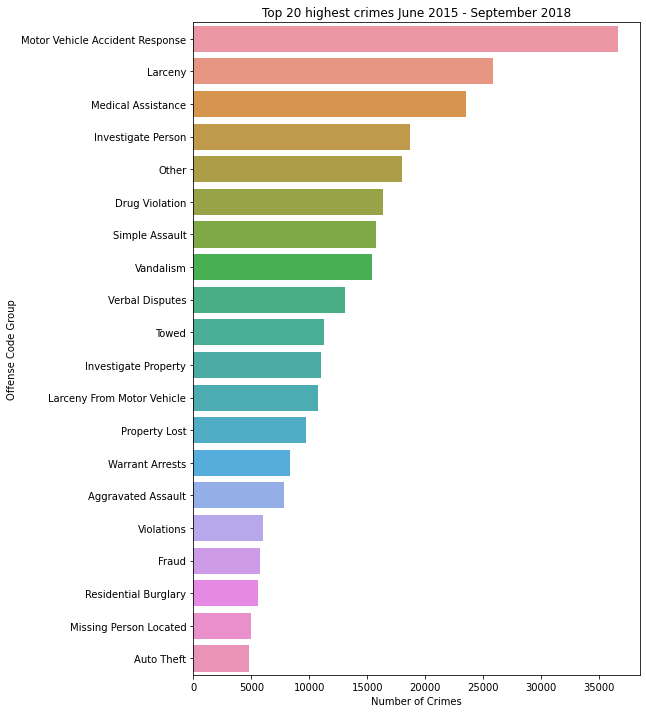

In [87]:
plt.figure(figsize=(8,12))

plt.title("Top 20 highest crimes June 2015 - September 2018")

sns.barplot(x=top_20,y=top_20.index)

plt.ylabel("Offense Code Group")
plt.xlabel("Number of Crimes")

Grafik di atas menunjukkan , kejadian yang paling sering terjadi adalah *Motor Vehicle Accident Response* yang merupakan respon/tanggapan terhadap suatu kecelakaan lalu lintas, kemudian diikuti *Larceny* di urutan kedua.

### *Trend* pelanggaran hukum per tahun dari 2015 hingga 2018

In [88]:
df_2015 = crimes.loc[crimes["Year"] == 2015]
value_counts1 = df_2015.Offense_Code_Group.value_counts()
crime_counts1 = pd.DataFrame(value_counts1)
crime_counts1 = crime_counts1.reset_index()
crime_counts1.columns = ["Offense_Code_Group", "2015"]

df_2016 = crimes.loc[crimes["Year"] == 2016]
value_counts2 =  df_2016.Offense_Code_Group.value_counts()
crime_counts2 = pd.DataFrame(value_counts2)
crime_counts2 = crime_counts2.reset_index()
crime_counts2.columns = ["Offense_Code_Group", "2016"]

df_2017 = crimes.loc[crimes["Year"] == 2017]
value_counts3 =  df_2017.Offense_Code_Group.value_counts()
crime_counts3 = pd.DataFrame(value_counts3)
crime_counts3 = crime_counts3.reset_index()
crime_counts3.columns = ["Offense_Code_Group", "2017"]

df_2018 = crimes.loc[crimes["Year"] == 2018]
value_counts4 =  df_2018.Offense_Code_Group.value_counts()
crime_counts4 = pd.DataFrame(value_counts4)
crime_counts4 = crime_counts4.reset_index()
crime_counts4.columns = ["Offense_Code_Group", "2018"]

crime_counts = pd.concat([crime_counts1,crime_counts2,crime_counts3,crime_counts4],axis=1)

In [89]:
crime_counts.describe()

,2015,2016,2017,2018
count,61.000000,61.000000,62.000000,59.000000
mean,872.819672,1615.721311,1617.241935,1103.813559
std,1235.800099,2306.852467,2397.169729,1598.003652
min,1.000000,1.000000,2.000000,6.000000
25%,89.000000,135.000000,120.250000,100.500000
50%,256.000000,532.000000,459.500000,355.000000
75%,1297.000000,1908.000000,1689.750000,1228.500000
max,5806.000000,11409.000000,11875.000000,7564.000000


Tabel di atas merupakan nilai statistik dekriptif yang memberikan petunjuk mengenai persebaran kelompok pelanggaran hukum setiap tahun. Semua tahun memiliki pola yang sama dan tidak memiliki distribusi yang simetris, *mean* lebih tinggi dari *median*. Ini artinya distribusi miring ke kanan atau *right skewed*.

Berikut grafik total pelanggaran hukum setiap tahun dari 2015 hingga 2018.

Text(-14.949999999999996, 0.5, 'count')

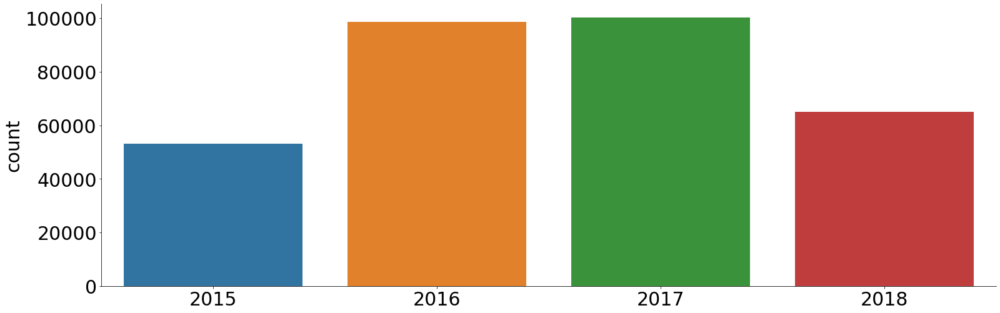

In [90]:
sns.catplot(x="Year",
           kind="count",
            height=7,
            aspect=3,
           data=crimes)
plt.xticks(size=30)
plt.yticks(size=30)
plt.xlabel("")
plt.ylabel("count", fontsize=30)

*Trend* pelanggaran hukum di tahun 2016 dan 2017 lebih tinggi dari 2 tahun lainnya. Namun, tahun 2015 dan 2018 tidak memiliki jumlah bulan yang sama dengan 2017 dan 2017, sehingga dibutuhkan data lebih dari 2015 dan 2018 untuk dapat menarik kesimpulan dari jumlah pelanggaran hukum pada tahun tersebut.

Total pelanggaran hukum per tahun berdasarkan *Offense_Code_Group*

In [91]:
fig = px.histogram(crimes, x = "Offense_Code_Group", template="plotly_white", opacity=0.7,
                   animation_frame = "Year", width=1100, height=1000)
fig.update_layout(xaxis_tickangle=60)
padding_top = 200

fig["layout"]["sliders"][0]["pad"]["t"] = padding_top
fig["layout"]["updatemenus"][0]["pad"]["t"] = padding_top

fig.show()

Tindak pelanggaran hukum terbanyak setiap tahun berdasarkan *Offense_Code_Group* sama, yaitu *Motor Vehicle Accident Response*.

### Membandingkan jumlah pelanggaran hukum yang terjadi berdasarkan bulan

In [92]:
crimes.head()

,Incident_ID,Offense_Code,Offense_Code_Group,Offense_Description,District,Reporting_Area,Shooting,Occurred_On,Year,Month,Day,Hour,UCR,District_Name,Latitude,Longitude,Month_Name
0,I182070945,619,Larceny,LARCENY ALL OTHERS,D14,808,N,2018-09-02 13:00:00,2018,9,Sunday,13,Part One,Allston & Brighton,42.357791,-71.139371,Sept
1,I182070943,1402,Vandalism,VANDALISM,C11,347,N,2018-08-21 00:00:00,2018,8,Tuesday,0,Part Two,Dorchester,42.306821,-71.060300,Aug
2,I182070941,3410,Towed,TOWED MOTOR VEHICLE,D4,151,N,2018-09-03 19:27:00,2018,9,Monday,19,Part Three,South End,42.346589,-71.072429,Sept
3,I182070940,3114,Investigate Property,INVESTIGATE PROPERTY,D4,272,N,2018-09-03 21:16:00,2018,9,Monday,21,Part Three,South End,42.334182,-71.078664,Sept
4,I182070938,3114,Investigate Property,INVESTIGATE PROPERTY,B3,421,N,2018-09-03 21:05:00,2018,9,Monday,21,Part Three,Mattapan,42.275365,-71.090361,Sept


In [93]:
crimemonthly=crimes.groupby("Month")["Incident_ID"].count().reset_index()
crimemonthly

,Month,Incident_ID
0,1,23515
1,2,21579
2,3,24035
3,4,23993
4,5,26106
5,6,30367
6,7,34248
7,8,34545
8,9,26324
9,10,25570


In [94]:
fig = go.Figure(layout={"height":600})
fig.add_trace(go.Bar(x=crimemonthly["Month"], y=crimemonthly["Incident_ID"]))
fig.update_layout(title="Number of Offenses every Month", xaxis_tickfont_size=14,
    yaxis=dict(title="Number of Offenses", titlefont_size=16, tickfont_size=14),
    xaxis=dict(title="Month", titlefont_size=16, tickfont_size=14))
fig.show()

Dari grafik di atas, dapat diambil kesimpulan sebagai berikut.
1. Pelanggaran hukum paling banyak terjadi pada bulan Agustus. Perlu diingat bahwa bulan Juni - September pada data ada 4 kali (2015 - 2018), sedangkan lainnya hanya 3 kali (Januari - Mei hanya 2016 - 2018 dan Oktober - Desember pada 2015 - 2017). Oleh karena itu, dibutuhkan data Januari - Mei 2015 dan Oktober - Desember 2018 untuk memastikan hal ini.
2. Bulan November hingga April adalah musim *Winter*. Ini adalah bulan-bulan dengan temperatur terendah di Amerika (umumnya -15 hingga 0 derajat Celcius) sehingga umumnya orang lebih banyak di rumah.

### Membandingkan jumlah pelanggaran hukum berdasarkan hari kejadian

In [95]:
crimes.Day = pd.Categorical(crimes.Day, 
              categories=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"],
              ordered=True)

Text(-8.699999999999989, 0.5, 'count')

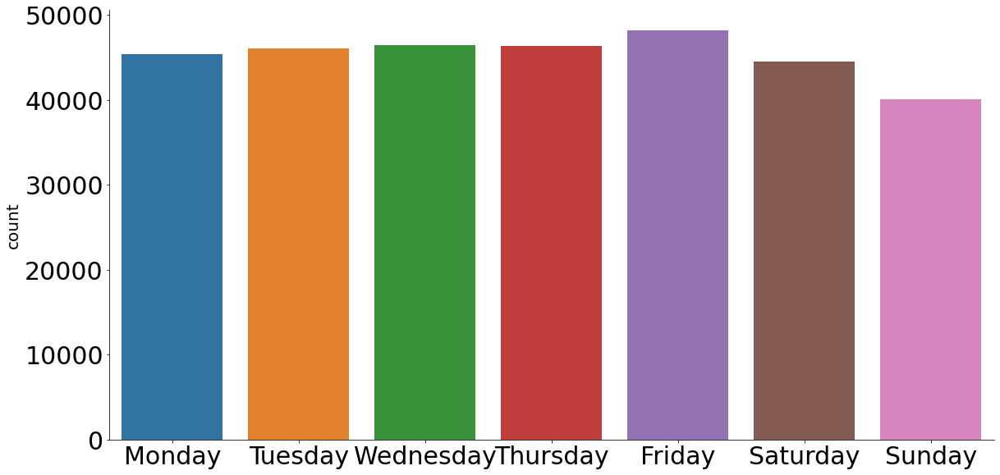

In [96]:
sns.catplot(x="Day",
           kind="count",
            height=8, 
            aspect=2,
           data=crimes)
plt.xticks(size=30)
plt.yticks(size=30)
plt.xlabel("")
plt.ylabel("count", fontsize=20)

Dari grafik di atas, walaupun secara keseluruhan cenderung stabil, namun pelanggaran hukum paling banyak terjadi di hari Jumat. Sabtu dan Minggu justru menjadi hari dengan pelanggaran paling sedikit. Perlu data dan analisa lebih lengkap untuk mengetahui kenapa kejadian paling banyak di hari Jumat. Selanjutnya dicek proporsi tiap jam di hari Jumat.

### Membandingkan jumlah pelanggaran hukum berdasarkan waktu kejadian

In [97]:
crimehour=crimes.groupby("Hour")["Incident_ID"].count().reset_index()
crimehour.head()

,Hour,Incident_ID
0,0,14968
1,1,9211
2,2,7628
3,3,4557
4,4,3393


In [98]:
fig = go.Figure(layout={"height":700})
fig.add_trace(go.Bar(x=crimehour["Hour"], y=crimehour["Incident_ID"]))
fig.update_layout(title="Number of Offenses every Hour", xaxis_tickfont_size=14,
    yaxis=dict(title="Number of Offenses", titlefont_size=16, tickfont_size=14),
    xaxis=dict(title="Time", titlefont_size=16, tickfont_size=14))
fig.show()

Dari grafik di atas, dapat diambil kesimpulan berikut.
1. terjadinya pelanggaran hukum paling banyak pada jam 16:00-18:59. Perlu dilihat lebih detail jenis pelanggaran yang terjadi untuk mengetahui apakah ini ada hubungannya dengan jam pulang kerja (*rush hour*) di mana orang lelah setelah seharian bekerja.
2. Pada jam 01:00-07:59 pagi, pelanggaran hukum cenderung rendah.

Bila dilihat dari kategori hari.

### Melihat hubungan hari libur nasional dengan pelanggaran hukum

Berikut ini akan dianalisis hubungan hari libur nasional dengan jumlah pelanggaran hukum yang terjadi. Diambil tahun yang lengkap bulannya saja, yaitu 2016 dan 2017.

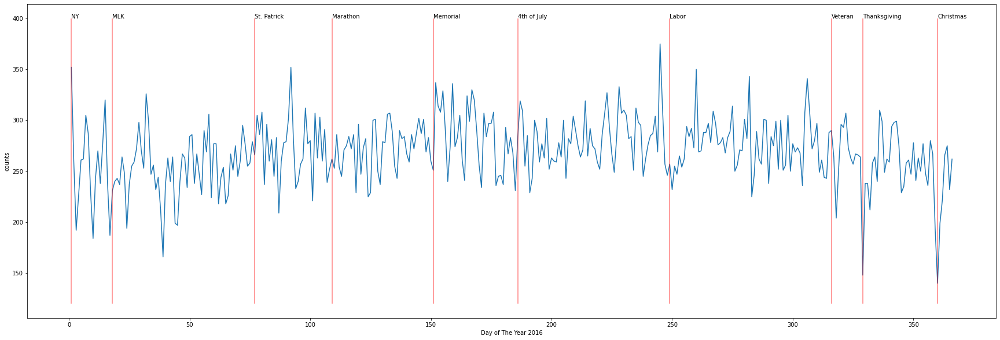

In [99]:
crimes["Day_Of_Year_2016"] = crimes["Occurred_On"].dt.dayofyear
data_holidays2016 = crimes[crimes["Year"] == 2016].groupby(["Day_Of_Year_2016"]).size().reset_index(name = "counts")

# Dates of major U.S. holidays in 2016
holidays2016 = pd.Series(["2016-01-01", # New Year's Day
                     "2016-01-18", # MLK Day
                     "2016-03-17", # St. Patrick's Day
                     "2016-04-18", # Boston Marathon
                     "2016-05-30", # Memorial Day
                     "2016-07-04", # Independence Day
                     "2016-09-05", # Labor Day
                     "2016-11-11", # Veterans Day
                     "2016-11-24", # Thanksgiving
                     "2016-12-25"]) # Christmas
holidays2016 = pd.to_datetime(holidays2016).dt.dayofyear
holidays_names = ["NY",
                 "MLK",
                 "St. Patrick",
                 "Marathon",
                 "Memorial",
                 "4th of July",
                 "Labor",
                 "Veteran",
                 "Thanksgiving",
                 "Christmas"]

import datetime as dt

# Plot crimes and holidays
fig, ax = plt.subplots(figsize=(30, 10))
sns.lineplot(x = "Day_Of_Year_2016",
            y = "counts",
            ax = ax,
            data = data_holidays2016)
plt.xlabel("Day of The Year 2016")
plt.vlines(holidays2016, 120, 400, alpha = 0.5, color ="red")
for i in range(len(holidays2016)):
    plt.text(x = holidays2016[i], y = 400, s = holidays_names[i])

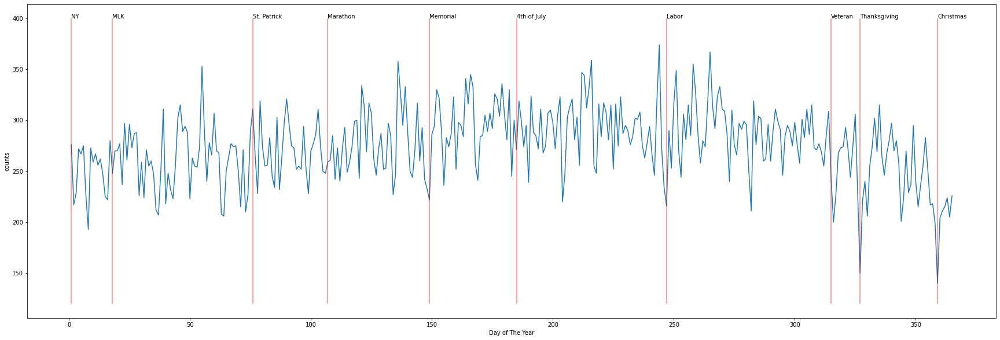

In [100]:
crimes["Day_Of_Year_2017"] = crimes["Occurred_On"].dt.dayofyear
data_holidays2017 = crimes[crimes.Year == 2017].groupby(["Day_Of_Year_2017"]).size().reset_index(name = "counts")

# Dates of major U.S. holidays in 2017
holidays2017 = pd.Series(["2017-01-01", # New Year's Day
                     "2017-01-18", # MLK Day
                     "2017-03-17", # St. Patrick's Day
                     "2017-04-17", # Boston Marathon
                     "2017-05-29", # Memorial Day
                     "2017-07-04", # Independence Day
                     "2017-09-04", # Labor Day
                     "2017-11-11", # Veterans Day
                     "2017-11-23", # Thanksgiving
                     "2017-12-25"]) # Christmas
holidays2017 = pd.to_datetime(holidays2017).dt.dayofyear
holidays_names = ["NY",
                 "MLK",
                 "St. Patrick",
                 "Marathon",
                 "Memorial",
                 "4th of July",
                 "Labor",
                 "Veteran",
                 "Thanksgiving",
                 "Christmas"]

import datetime as dt

# Plot crimes and holidays
fig, ax = plt.subplots(figsize = (30, 10))
sns.lineplot(x = "Day_Of_Year_2017",
            y = "counts",
            ax = ax,
            data = data_holidays2017)
plt.xlabel('Day of The Year')
plt.vlines(holidays2017, 120, 400, alpha=0.5, color = "red")
for i in range(len(holidays2017)):
    plt.text(x = holidays2017[i], y = 400, s = holidays_names[i])

### Distrik dengan pelanggaran hukum terbanyak

In [101]:
mostcrimesdistrict = crimes.groupby("District_Name")["Incident_ID"].count().reset_index()
mostcrimesdistrict

,District_Name,Incident_ID
0,Allston & Brighton,20118
1,Charlestown,6505
2,Dorchester,42513
3,Downtown,35708
4,E18,17339
5,East Boston,13541
6,Hyde Park,17530
7,Mattapan,35428
8,Roxbury,49924
9,South Boston,23451


In [102]:
fig = go.Figure(layout={"height":700})
fig.add_trace(go.Bar(x=mostcrimesdistrict["District_Name"], y=mostcrimesdistrict["Incident_ID"]))
fig.update_layout(title="Number of Offenses each District", xaxis_tickfont_size=14,
    yaxis=dict(title="Number of Offenses", titlefont_size=16, tickfont_size=14),
    xaxis=dict(title="District", titlefont_size=16, tickfont_size=14))
fig.show()

### Geospatial Map Plotting

#### Heatmap

In [103]:
heatmap = folium.Map(location=[42.360351710236614, -71.05797189828955], tiles="cartodbpositron", zoom_start=12)

HeatMap(data=crimes[["Latitude", "Longitude"]], radius=10).add_to(heatmap)
heatmap

## Kesimpulan dan Rekomendasi 

**Kesimpulan**

Dari analisis yang telah dilakukan, dapat diambil kesimpulan sebagai berikut.
1.  Dari 317,195 data yang dimiliki, hanya memiliki 280,891 kejadian pelanggaran hukum. Ini artinya dalam satu kasus terjadi banyak tindakan. Maksudnya adalah terdapat beberapa *Incident_ID* dengan *Offense_Code_Group* berbeda.
2. *Motor Vehicle Accident Response* menjadi *Offense_Code_Group* yang paling sering terjadi dalam kurun waktu Juni 2015 hingga September 2018.
3. Jumlah pelanggaran 2015 dan 2018 tidak akurat karena hanya memiliki data dalam beberapa bulan saja, sedangkan 2016 dan 2017 memiliki data lengkap dari bulan Januari hingga Desember. Oleh karena itu, wajar jika tingkat kejahatan pada tahun 2015 dan 2018 lebih rendah dari 2016, walaupun belum tentu akan sama atau lebih banyak bila data *full* dari bulan Januari hingga Desember.
4. Kategori pelanggaran hukum tertinggi selalu sama setiap tahunnya, yaitu *Motor Vehicle Accident Response*.
5. Pelanggaran hukum paling banyak terjadi pada bulan Agustus. Perlu diingat bahwa bulan Juni - September pada data ada 4 kali (2015 - 2018), sedangkan lainnya hanya 3 kali (Januari - Mei hanya 2016 - 2018 dan Oktober - Desember pada 2015 - 2017). Oleh karena itu, dibutuhkan data Januari - Mei 2015 dan Oktober - Desember 2018 untuk memastikan hal ini.
6. Pelanggaran hukum paling banyak terjadi di hari Jumat.
7. Pelanggaran hukum paling banyak terjadi pada jam 16:00-18:59. Perlu dilihat lebih detail jenis pelanggaran yang terjadi untuk mengetahui apakah ini ada hubungannya dengan jam pulang kerja (*rush hour*) di mana orang lelah setelah seharian bekerja.
8. Hubungan antara hari libur nasional dengan jumlah tindak pelanggaran hukum tidak dapat disimpulkan. Beberapa kejahatan tinggi terjadi pada hari libur nasional, namun tidak sedikit yang kejadian pelanggarannya menurun pada hari libur nasional, seperti ketika Thanksgiving dan Natal.
9. *District* dengan kasus terbanyak terdapat di Roxbury.
10. Dibutuhkan data lebih banyak untuk mengetahui bagaimana *trend* pelanggaran hukum di Boston setiap tahunnya. Seperti yang dijelaskan pada point 5, trend hanya bisa dilihat dari 2016 hingga 2017. Apabila hanya ada dua tahun, hasil kesimpulan tidak akurat. Oleh karena itu, tidak dapat disimpulkan apakah Boston PD sudah berhasil menekan tindak kejahatan atau pelanggaran hukum atau belum.

**Rekomendasi**

1. Perlu ditingkatkan patroli di jalan raya karena bila dilihat dari data, *Motor Vehicle Accident Response* menjadi yang paling banyak terjadi setiap tahun dari Juni 2015 hingga September 2018. Perlu ditingkatkan patroli polisi yang berjaga di jalan raya.
2. Boston PD perlu meningkatkan jumlah petugas kepolisian serta paramedik pada bulan Juni hingga Agustus dan memperbanyak petugas yang berpatroli.
3. Hari Jumat merupakan hari yang lebih sibuk dari hari-hari lainnya bagi Boston PD. Oleh karena itu dibutuhkan *police officer* yang cukup untuk mengamankan wilayah Boston.
4. Jam pergantian *shift* dilakukan tidak pada jam sibuk, terutama antara jam 4 sore hingga 8 malam. Lebih baik dilakukan pada pagi hari ketika jam yang memiliki kasus pelanggaran hukum paling sedikit.
5. Pada hari libur nasional, patroli petugas tetap diperlukan untuk menjaga ketertiban. Namun, pada hari-hari dengan kasus terjadi pelanggaran hukum tinggi, penjagaan perlu ditingkatkan.
6. Roxbury perlu memiliki lebih banyak polisi karena memiliki kasus pelanggaran hukum terbanyak dan cukup signifikan dibanding *district-district* lainnya.
7. Sosialisasi ke masyarakat, bahkan bisa dimulai dari anak-anak di sekolah, bahwa tindakan pelanggaran hukum apapun akan merusak hidup pelaku dan korbannya secara permanen. Korban mungkin akan mendapat PTSD (Post-Traumatic Stress Disorder), *anxiety*, atau akibat apapun dari kejadian. Sedangkan untuk pelakunya, *clean record* rusak dengan adanya catatan pelanggaran yang dilakukan. Hal ini akan mempengaruhi peluang seseorang untk mendapatkan kerja atau melakukan hidup secara normal lainnya karena adanya catatan pelanggaran hukum.

In [104]:
# # Excel Top 20

# top_20 = top_20.to_frame()
# top_20.reset_index(drop=False,inplace=True)
# top_20

In [105]:
# top_20.to_excel('top20.xlsx')

In [106]:
# # Excel trend pelanggaran hukum setiap tahun

# crimesyearly= crimes.groupby('Year')[['Year']].value_counts()
# crimesyearly= crimesyearly.to_frame()
# crimesyearly.reset_index(inplace=True)
# crimesyearly.rename(columns = {0:"Total"},inplace=True)
# crimesyearly

In [107]:
# crimesyearly.to_excel('crimesyearly.xlsx')

In [108]:
# # total pelanggaran hukum tiap tahun berdasarkan Offense_Code_Group

# crimesyearoffense= crimes.groupby('Year')[['Offense_Code_Group']].value_counts()
# crimesyearoffense= crimesyearoffense.to_frame()
# crimesyearoffense.reset_index(inplace=True)
# crimesyearoffense.rename(columns = {0:"Total"},inplace=True)
# crimesyearoffense

In [109]:
# crimesyearoffense.to_excel('totalperoffenseperyear.xlsx')

In [110]:
# # total pelanggaran hukum tiap bulan berdasarkan Incident_ID

# crimemonthly= crimes.groupby('Month')[['Month']].value_counts()
# crimemonthly= crimemonthly.to_frame()
# crimemonthly.reset_index(inplace=True)
# crimemonthly.rename(columns = {0:"Total"},inplace=True)
# crimemonthly

In [111]:
# crimemonthly.to_excel('totalperoffensepermonth.xlsx')

In [112]:
# # Total pelanggaran hukum setiap hari

# crimesdayoffense= crimes.groupby('Day')[['Day']].value_counts()
# crimesdayoffense= crimesdayoffense.to_frame()
# crimesdayoffense.reset_index(inplace=True)
# crimesdayoffense.rename(columns = {0:"Total"},inplace=True)
# crimesdayoffense

In [113]:
# crimesdayoffense.to_excel('crimesdayoffense.xlsx')

In [114]:
# # # total pelanggaran hukum tiap jam berdasarkan Incident_ID

# crimehour= crimes.groupby('Hour')[['Hour']].value_counts()
# crimehour= crimehour.to_frame()
# crimehour.reset_index(inplace=True)
# crimehour.rename(columns = {0:"Total"},inplace=True)
# crimehour

In [115]:
# crimehour.to_excel('crimehour.xlsx')

In [116]:
# # Total pelanggaran hukum vs National Holidays (2016)

# data_holidays2016 = crimes[crimes.Year == 2016].groupby(["Day_Of_Year_2016"]).size().reset_index(name = "counts")
# data_holidays2016

In [117]:
# data_holidays2016.to_excel('data_holidays2016.xlsx')

In [118]:
# # Total pelanggaran hukum vs National Holidays (2017)

# data_holidays2017 = crimes[crimes.Year == 2017].groupby(["Day_Of_Year_2017"]).size().reset_index(name = "counts")
# data_holidays2017

In [119]:
# data_holidays2017.to_excel('data_holidays2017.xlsx')

In [120]:
# # Distrik dengan pelanggaran hukum terbanyak

# crimesdistrictname = crimes.groupby('District_Name')[['Incident_ID']].count()
# crimesdistrictname

In [121]:
# crimesdistrictname.to_excel('crimesdistrictname.xlsx')

In [122]:
# crimes.head()

In [123]:
# pinpoint2 = crimes[['Incident_ID', 'Offense_Code_Group', 'District_Name', 'Latitude', 'Longitude']]
# pinpoint2

In [124]:
# pinpoint2.to_excel('pinpoint2.xlsx')